In [560]:
import os
import sys
import numpy as np
import nibabel as nib
import pydicom
import math
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from numpy import zeros, newaxis
from scipy.stats import norm
import scipy.stats as stats
import cv2
import scipy.signal as signal
from pydicom.pixel_data_handlers.util import apply_color_lut
from skimage.filters import threshold_multiotsu
from skimage.filters import threshold_otsu, threshold_local
import SimpleITK as sitk
from scipy import spatial
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
import skimage

from sklearn.linear_model import LinearRegression
import scipy.optimize

%run utils/handlers.ipynb
%run utils/plotters.ipynb

# Util functions

In [2]:
# def get_baseline_vals(img_s, seg, segmentationArr, data):
#     """
#     img_s: image slice to be analysed
#     seg: segmentation id of baseline
#     segmentationArr: segmentation np array
#     data: mri raw np array
    
#     returns;
#     baseline: pixel values for baseline area nparray (len(vals), len(echos))
#     """
#     segmentation=segmentationArr[:,:,img_s]
#     num_echos=data.shape[-1]
    
#     for echo in range(num_echos):
#         img=data[:,:,img_s,echo]
#         vals=img[segmentation==seg]

#         if echo==0:
#             baseline=np.zeros((len(vals),8))
#             baseline[:,0]=vals
#         else:
#             baseline[:,echo]=vals
            
#     return baseline

In [561]:
def single_baseline(elecSeg, img_slice, baseStruct, root, analysedPath, labelsdf):
#     struct="crtx"
    print("Baseline structure: "+baseStruct)
    base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"]==baseStruct].values[0]
    baseline=get_baseline_vals(img_slice, base_seg, coronal1seg, coronal1data)        
    segmentation_mask=coronal1seg[:,:,img_slice]

#     segname="mono"
    elec_segs=labelsdf["Labels"][labelsdf["Anatomical Regions"]==elecSeg].values
    print("Segment of interest: "+elecSeg)
    save_path=root+analysedPath+elecSeg+"-"+baseStruct+"_base/"
    dpi=1000
    savefigs=True
    zthr=-1.95

    if not os.path.exists(save_path):
        os.mkdir(save_path)

    num_echos=coronal1data.shape[-1]
    mean_intensities=np.zeros([len(elec_segs),num_echos])

    px_count=np.zeros((len(elec_segs),num_echos))
    px_intensities=[]

    for j,seg in enumerate(elec_segs):
        tmpvals=[]
        for echo in range(num_echos):
            img=coronal1data[:,:,img_slice,echo]
            imgz=img_zscore(img,baseline,echo)
    #         imgz=(img-np.mean(baseline[:,echo]))/np.std(baseline[:,echo])

            imgz=imgz*(segmentation_mask==seg)
            vals_z=imgz[segmentation_mask==seg]
            ind=np.where(imgz<zthr)
            px_count[j, echo]=np.sum(vals_z<zthr)
            vals=img[ind]
            tmpvals.append(vals)
            mean_intensities[j,echo]=np.mean(vals)

            plt.imshow(img, cmap='gray')
            plt.scatter(ind[1],ind[0], c='r', s=0.01)
            if savefigs:
                filename=elecSeg+str(seg)+"echo"+str(echo)+".png"
                plt.savefig(save_path+filename, dpi=dpi)
            plt.show()

        px_intensities.append(tmpvals)

In [4]:
def monoExp(x, C, t2, A):
    return C * np.exp(-x/t2) + A
def monoExp2(x,params):  
#     C=15.028
    C=params[0]
    t2=params[1]
    A=params[2]
#     A=1
#     C=C
#     A=0
    return C * np.exp(-x/t2) + A


def relaxation(data, elecSegment, baseline, masks, echos=np.linspace(5,40,8), savepath=""):
    pxIntMeans=np.empty((len(echos),))
    pxIntstd=np.empty((len(echos),))
    for echo in range(len(echos)-1):
        img=data[:,:,echo]
        pxIntMeans[echo]=np.mean(img[masks[elecSegment,-1,:,:]==1])
        pxIntstd[echo]=np.std(img[masks[elecSegment,-1,:,:]==1])
#         pxIntMeans[echo]=np.mean(img[masks[elecSegment,echo+1,:,:]==1])
#         pxIntstd[echo]=np.std(img[masks[elecSegment,echo+1,:,:]==1])
    
    img=data[:,:,-1]
    pxIntMeans[-1]=np.mean(img[masks[elecSegment,-1,:,:]==1])
    pxIntstd[-1]=np.std(img[masks[elecSegment,-1,:,:]==1])
    
    p0=(50, 30,0)
    paramsBase, cvBase = scipy.optimize.curve_fit(monoExp, echos, np.mean(baseline,axis=0), p0, np.std(baseline,axis=0), bounds=([-np.inf,-np.inf,0],[np.inf,np.inf,np.inf]))
    Cbase,t2Base,Abase = paramsBase
    
    if Abase>np.std(baseline,axis=0)[-1]:
        Alower=Abase-np.std(baseline,axis=0)[-1]
    else:
        Alower=0
    Aupper=Abase+np.std(baseline,axis=0)[-1]
    
    paramsData, cvData = scipy.optimize.curve_fit(monoExp, echos, pxIntMeans, paramsBase, pxIntstd, bounds=([Cbase-np.std(baseline,axis=0)[0], -np.inf, Alower], [Cbase+np.std(baseline,axis=0)[0],np.inf,Aupper]))
    Celec,t2elec,Aelec = paramsData
    
    plt.figure()
    plt.errorbar(echos, pxIntMeans, yerr=pxIntstd, fmt='o', color="blue")
    plt.plot(np.linspace(0,40,9), monoExp(np.linspace(0,40,9), Celec, t2elec, Aelec), color="blue", linewidth=3)
    
    plt.errorbar(echos, np.mean(baseline,axis=0), yerr=np.std(baseline,axis=0), fmt='o', color="red")
    plt.plot(np.linspace(0,40,9), monoExp(np.linspace(0,40,9), Cbase, t2Base, Abase), color="red", linewidth=3)
    
    
    plt.ylabel("Signal a.u.")
    plt.xlabel("Time (ms)")
    plt.legend(["Electrode echo",  "Electrode Decay"])
    if savepath:
        plt.savefig(savepath+"elec"+str(elecSegment)+"_relaxation.pdf")
    plt.show()
    
    return paramsBase, paramsData


def relaxation_fixedROI(data, center,  elecSegment, baseline, r=3, echos=np.linspace(5,40,8), savepath="", baseName=""):

    disk=skimage.morphology.disk(r)
    x,y=center
    pxIntMeans=np.empty((len(echos),))
    pxIntstd=np.empty((len(echos),))
    
    for echo in range(len(echos)):
        img=data[:,:,echo]
        mask=np.zeros((256,256))
        mask[x-r:x+r+1, y-r:y+r+1]=disk
        
        pxIntMeans[echo]=np.mean(img[mask==1])
        pxIntstd[echo]=np.std(img[mask==1])
        
    p0=(50, 30,0)
    paramsBase, cvBase = scipy.optimize.curve_fit(monoExp, echos, np.mean(baseline,axis=0), p0, np.std(baseline,axis=0), bounds=([-np.inf,-np.inf,0],[np.inf,np.inf,np.inf]))
    Cbase,t2Base,Abase = paramsBase
    p_sigma_base = np.sqrt(np.diag(cvBase))

    
    if Abase>np.std(baseline,axis=0)[-1]:
        Alower=Abase-np.std(baseline,axis=0)[-1]
    else:
        Alower=0
    Aupper=Abase+np.std(baseline,axis=0)[-1]
    
    paramsData, cvData = scipy.optimize.curve_fit(monoExp, echos, pxIntMeans, paramsBase, pxIntstd, bounds=([Cbase-np.std(baseline,axis=0)[0], -np.inf, Alower], [Cbase+np.std(baseline,axis=0)[0],np.inf,Aupper]))
    Celec,t2elec,Aelec = paramsData
    p_sigma_data = np.sqrt(np.diag(cvData))
    
    plt.figure()
    plt.errorbar(echos, pxIntMeans, yerr=pxIntstd, fmt='o', color="blue")
    plt.plot(np.linspace(0,40,9), monoExp(np.linspace(0,40,9), Celec, t2elec, Aelec), color="blue", linewidth=3)
    
    plt.errorbar(echos, np.mean(baseline,axis=0), yerr=np.std(baseline,axis=0), fmt='o', color="red")
    plt.plot(np.linspace(0,40,9), monoExp(np.linspace(0,40,9), Cbase, t2Base, Abase), color="red", linewidth=3)
    plt.grid()
    
    plt.ylabel("Signal a.u.")
    plt.xlabel("Time (ms)")
    plt.legend(["Electrode relaxation",  baseName+" relaxation"])
    if savepath and baseName:
        plt.savefig(savepath+"fixedROI-r:"+str(r)+"_elec"+str(elecSegment)+"_"+baseName+"_relaxation.pdf")
    plt.show()
    
    return paramsBase, paramsData, p_sigma_base, p_sigma_data

# rEO_08

In [273]:
root="/Users/eminhanozil/Dropbox (Yanik Lab)/Localization Manuscript 2024/RAT DATA/rEO_08/"
bids="mri-raw/bids/sub-rEO_08/ses-postsurgery20240502/anat/"
analysed="mri-analysed/"

## Mono, coronal:1, slice:3, 

In [290]:
coronal1filename="sub-rEO_08_ses-postsurgery20240502_task-coronal_acq-T2starMapMGE_T2w-ind_9.nii.gz"
coronal1segfilename="rEO_08-coronal-t2sMGE-segmentation.nii.gz"
labelspath="rEO_08-coronal-t2sMGE-labels.txt"
_, coronal1data=read_data(root+bids+coronal1filename)
_, coronal1seg=read_data(root+bids+coronal1segfilename)
labelsdf=read_labels(root+bids+labelspath)

Segment of interest: mono sitk-label:0    1
Name: Labels, dtype: int64


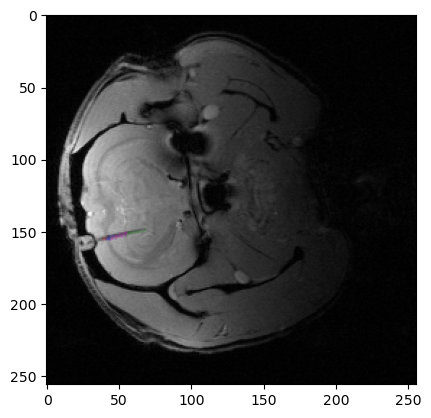

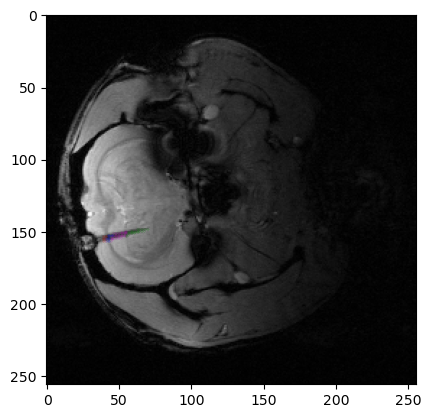

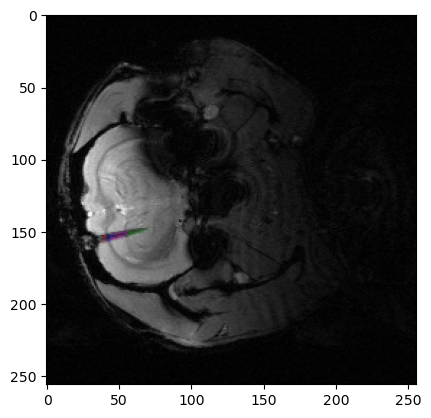

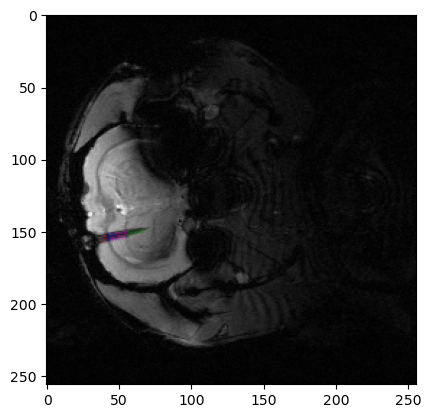

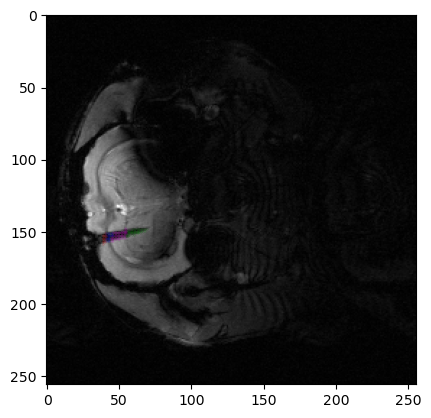

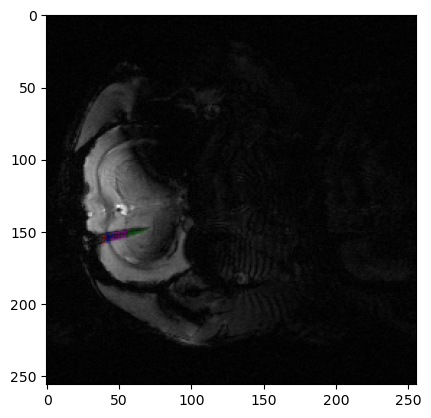

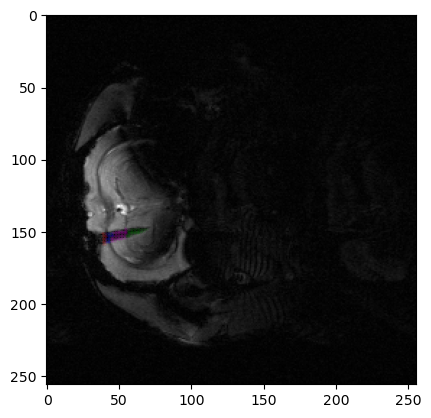

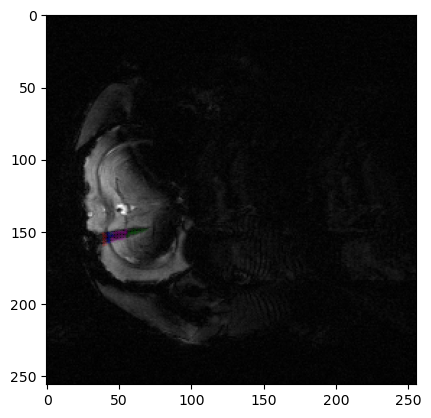

In [276]:
basestruct=["crtx","cc","hpc", "thlms"]
segname="mono"
img_slice=2
segmentation_mask=coronal1seg[:,:,img_slice]
# seg_areas=labelsdf["Labels"][labelsdf["Anatomical Regions"]==segname].values
seg_areas=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(segname)]
print("Segment of interest: "+segname+" sitk-label:"+str(seg_areas))
save_path=root+analysed+segname+"-regionspecific/"
dpi=1000
savefigs=False
zthr=-1.95

if not os.path.exists(save_path+"roi/"):
    os.mkdir(save_path+"roi/")

num_echos=coronal1data.shape[-1]
px_intensities=[]

masks=np.zeros((len(seg_areas), num_echos, segmentation_mask.shape[0],segmentation_mask.shape[1]))
for j,seg in enumerate(seg_areas):
    tmpvals=[]
    for echo in range(num_echos):
        echovals=[]
        crtxidx=[]
        hpcidx=[]
        thlmsidx=[]
        ccidx=[]
        indx=[]
        indy=[]

        img=coronal1data[:,:,img_slice,echo]
        for index in np.array(list(zip(*np.where(segmentation_mask==seg)))):
            base_seg,struct,_,_=get_neigh_basestruct(index, basestruct, labelsdf, segmentation_mask)
            baseline=get_baseline_vals(base_seg, segmentation_mask, coronal1data[:,:,img_slice,:])        
            imgz=img_zscore(img[index[0],index[1]],baseline[:,echo])
            
            if imgz<zthr:
                indx.append(index[0])
                indy.append(index[1])
                
                if struct=="crtx":
                    crtxidx.append(index)
                elif struct =="cc":
                    ccidx.append(index)
                elif struct=="hpc":
                    hpcidx.append(index)
                elif struct=="thlms":
                    thlmsidx.append(index)
                    
                echovals.append(img[index[0],index[1]])
                masks[j,echo,index[0],index[1]]=1

        crtxidx=np.array(crtxidx)
        ccidx=np.array(ccidx)
        hpcidx=np.array(hpcidx)
        thlmsidx=np.array(thlmsidx)

        tmpvals.append(echovals)
        
        plt.imshow(img, cmap='gray')
        plt.scatter(crtxidx[:,1], crtxidx[:,0], c='r', s=0.01)
        plt.scatter(ccidx[:,1], ccidx[:,0], c='b', s=0.01)
        plt.scatter(hpcidx[:,1], hpcidx[:,0], c='m', s=0.01)
        plt.scatter(thlmsidx[:,1], thlmsidx[:,0], c='g', s=0.01)
#         plt.scatter(indy, indx, c='r', s=0.01)
        if savefigs:
            filename=segname+str(seg)+"echo"+str(echo)+".png"
            plt.savefig(save_path+"roi/"+filename, dpi=dpi)
        plt.show()
        
    px_intensities.append(tmpvals)

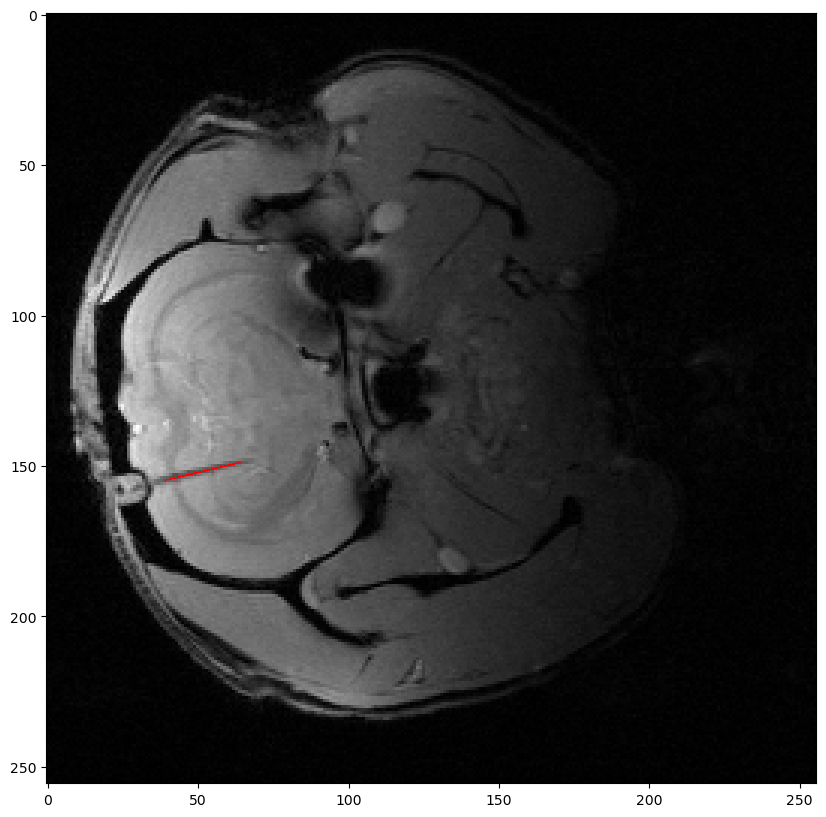

In [277]:
echo=1
pxIdxValsSorted=get_sorted_pxls(coronal1data[:,:,img_slice,echo], coronal1seg[:,:,img_slice], 1)
# def linefit(pxIdxValsSorted, numMins=40, d=1, save_path="", filename=""):
numMins=44
d=1
z=np.polyfit(pxIdxValsSorted[:numMins,1], pxIdxValsSorted[:numMins,0], d)
img=coronal1data[:,:,img_slice,0]
plt.figure(figsize=(10,10))
plt.imshow(img,cmap='gray')
plt.scatter(pxIdxValsSorted[:numMins,1], pxIdxValsSorted[:numMins,0], c='r', s=0.01)
plt.plot(pxIdxValsSorted[:numMins,1], pxIdxValsSorted[:numMins,1]*z[0]+z[1], c='r', linewidth=0.5)
filename="mono_linefit.png"
# if save_path and filename:
#     plt.savefig(save_path+filename, dpi=1000)
plt.show()

In [278]:
# Simply iterating over unique x-values and corresp y from linefit
x=pxIdxValsSorted[:numMins,1]
x=np.sort(x)
onset=1
offset=5
start=2
x=np.round(np.linspace(x[start]-onset, x[-1]+offset, int(x[-1]+offset-x[start]+onset+1))).astype(int)
y=np.round(x*z[0]+z[1]).astype(int)
print(x)
print(y)

[40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63
 64 65 66 67 68 69]
[155 154 154 154 154 153 153 153 153 152 152 152 152 151 151 151 151 150
 150 150 150 150 149 149 149 149 148 148 148 148]


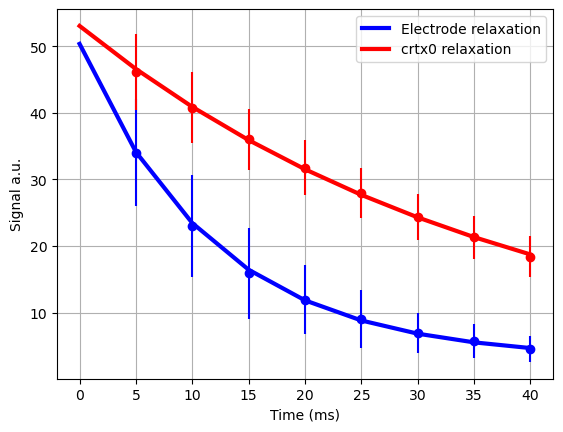

baseline:crtx
t2star tissue: 26.024409951197782
t2star electrode: 84.11344731074058
difference: 58.0890373595428
center: 40,155


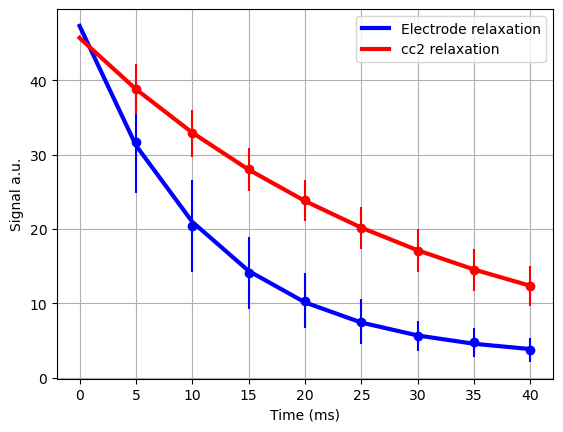

baseline:cc
t2star tissue: 32.692620287046125
t2star electrode: 88.94589802821655
difference: 56.25327774117042
center: 42,154


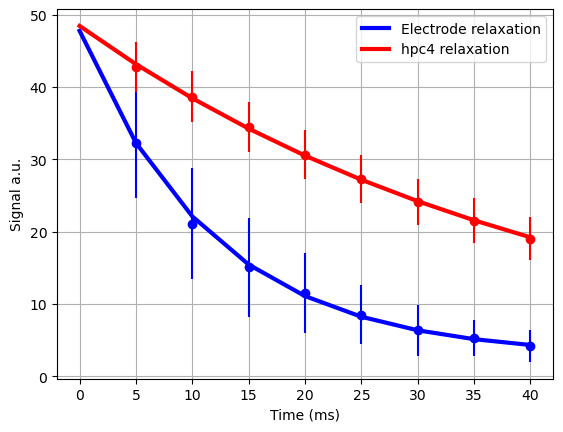

baseline:hpc
t2star tissue: 23.124030686643884
t2star electrode: 84.56117703048109
difference: 61.437146343837206
center: 44,154


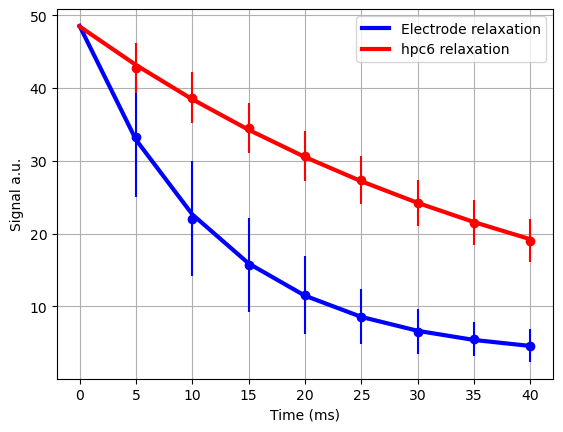

baseline:hpc
t2star tissue: 23.124030686643884
t2star electrode: 84.06007433809303
difference: 60.93604365144915
center: 46,153


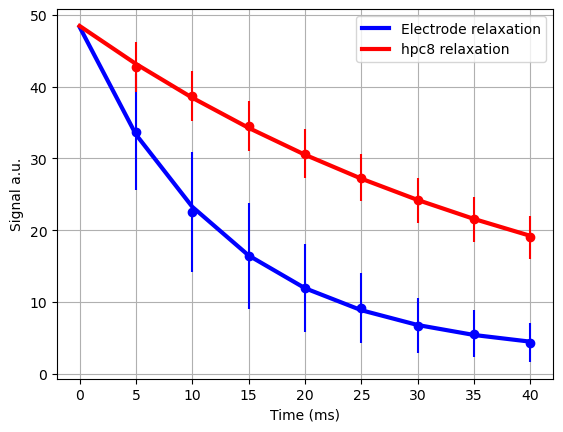

baseline:hpc
t2star tissue: 23.124030686643884
t2star electrode: 79.34228581566087
difference: 56.21825512901699
center: 48,153


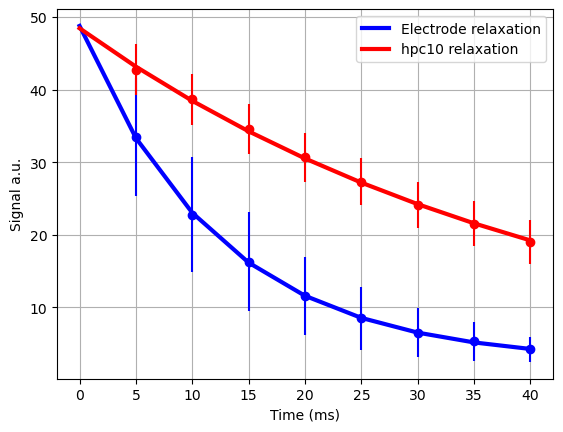

baseline:hpc
t2star tissue: 23.124030686643884
t2star electrode: 81.2392388669169
difference: 58.11520818027302
center: 50,152


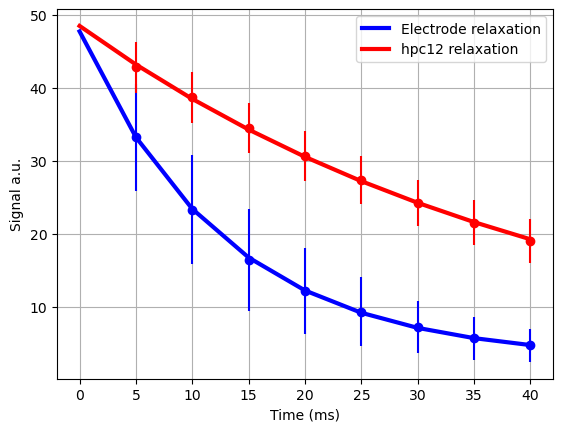

baseline:hpc
t2star tissue: 23.124030686643884
t2star electrode: 77.87215154643607
difference: 54.74812085979219
center: 52,152


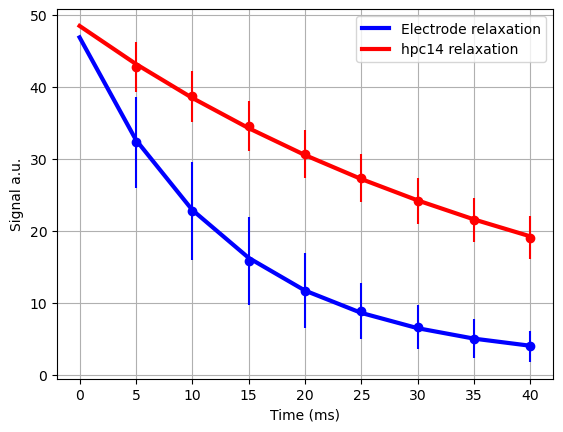

baseline:hpc
t2star tissue: 23.124030686643884
t2star electrode: 76.18842072905095
difference: 53.06439004240706
center: 54,151


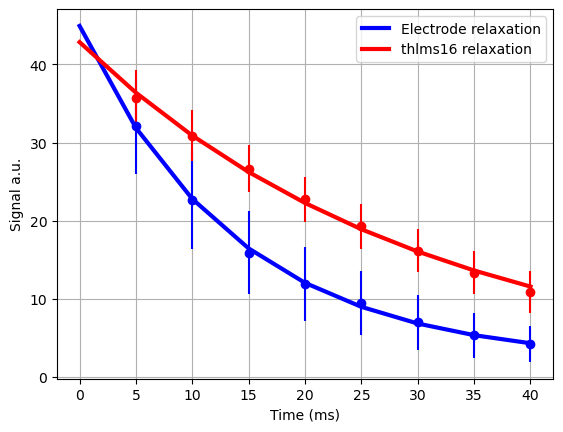

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 72.4057172176336
difference: 39.68135078228816
center: 56,151


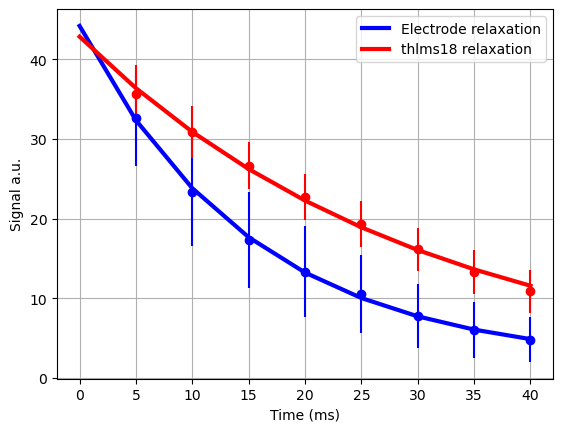

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 65.50002920317952
difference: 32.77566276783409
center: 58,150


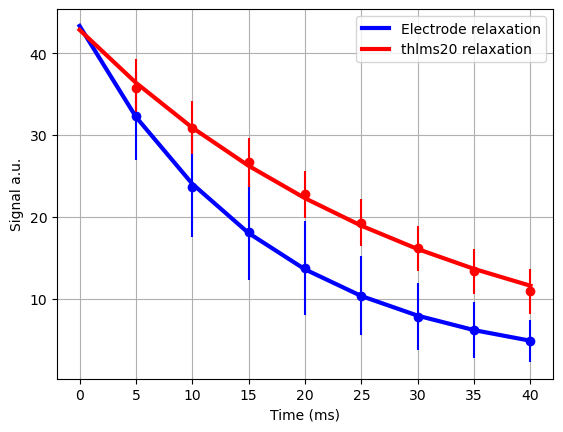

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 61.350482703008495
difference: 28.626116267663065
center: 60,150


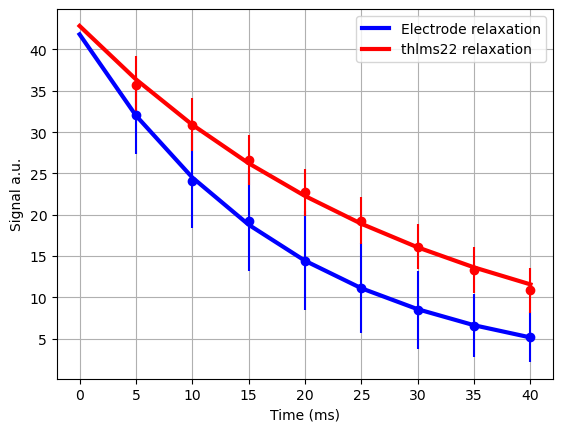

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 54.14107918723383
difference: 21.416712751888397
center: 62,149


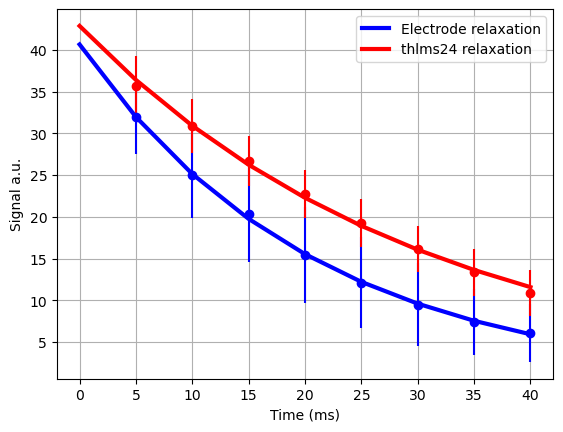

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 48.109062372928655
difference: 15.384695937583224
center: 64,149


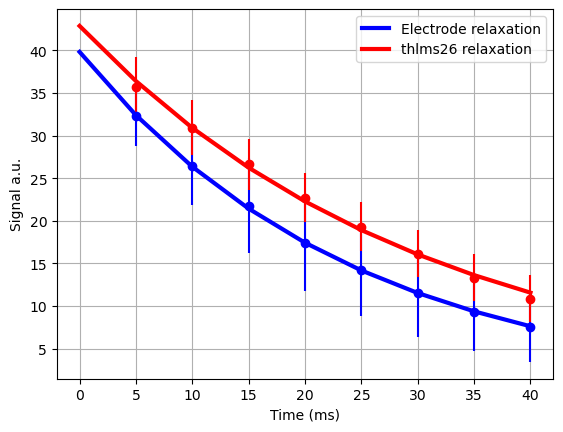

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 41.29210078813071
difference: 8.56773435278528
center: 66,148


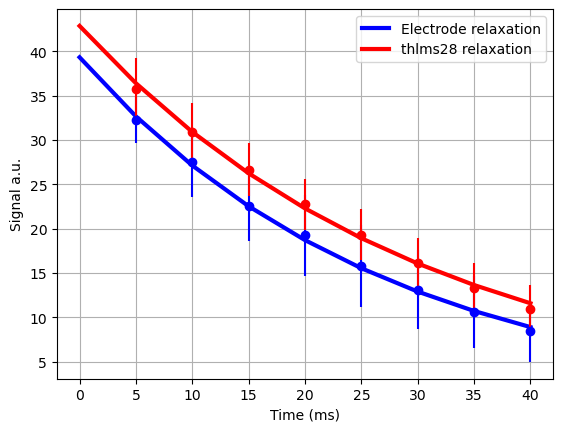

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 37.16903156059883
difference: 4.444665125253401
center: 68,148


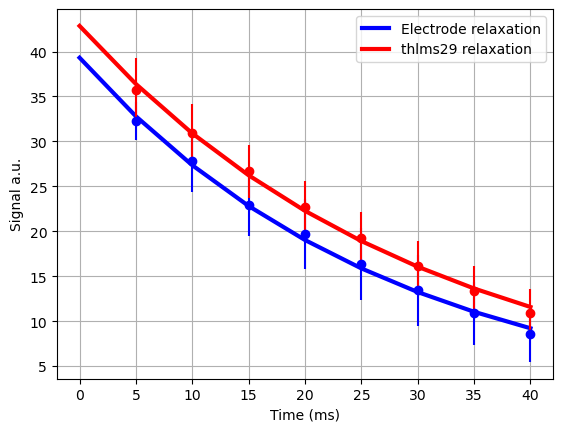

baseline:thlms
t2star tissue: 32.72436643534543
t2star electrode: 36.289538903506184
difference: 3.5651724681607533
center: 69,148


In [280]:
basestructs=["crtx","cc","hpc", "thlms"]

t2diffMono=[]
bundleLenMono=[]
for i in range(len(x)):
    if i==0:
        p0=np.array([y[i],x[i]])
#     else:
    if i%2==0 or i==len(x)-1:
        base_seg,struct,_,_=get_neigh_basestruct([y[i],x[i]], basestructs, labelsdf, segmentation_mask)
        baseline=get_baseline_vals(base_seg, segmentation_mask, coronal1data[:,:,img_slice,:])
        paramsBase, paramsData, _, _=relaxation_fixedROI(coronal1data[:,:,img_slice,:],[y[i],x[i]],
                                                         elecSegment='mono',
                                                         baseline=baseline,r=3,
                                                        savepath=save_path+"relaxation/", baseName=struct+str(i))
    #     if i%3==0:
        print("baseline:"+struct)
        print("t2star tissue: "+str(1000/paramsBase[1]))
        print("t2star electrode: "+str(1000/paramsData[1]))
        print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
        print("center: "+ str(x[i])+","+str(y[i]))
        t2diffMono.append(1000/paramsData[1]-1000/paramsBase[1])
        p1=np.array([y[i],x[i]])
        bundleLenMono.append(np.linalg.norm(p1-p0)*136)

    #     t2diff.append(1000/paramsData[1]-1000/paramsBase[1])

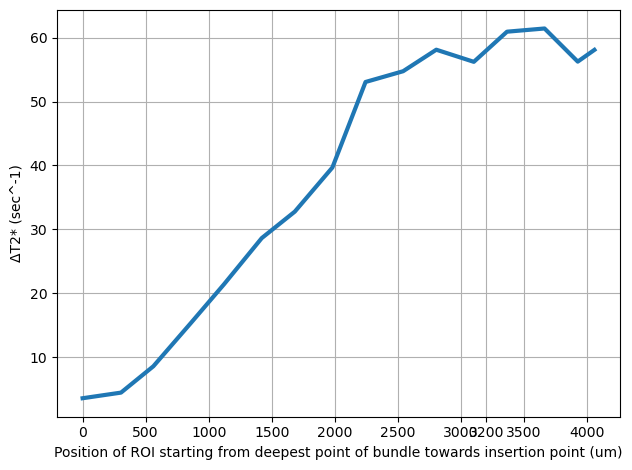

In [281]:
plt.figure()
plt.plot(bundleLenMono, np.flip(t2diffMono), linewidth=3)
plt.ylabel("ΔT2* (sec^-1)")
plt.xlabel("Position of ROI starting from deepest point of bundle towards insertion point (um)")
plt.tight_layout()
plt.xticks([0,500,1000,1500,2000,2500,3000,3200,3500,4000])
plt.grid()
plt.savefig(save_path+"relaxation_movingROI_stride2_r3.pdf")
#TODO: save data as npy

In [285]:
bundleLenMono=np.array(bundleLenMono)
# np.save()
filename="mono-bundle-length.npy"
np.save(save_path+filename, bundleLenMono)

t2diffMono=np.array(np.flip(t2diffMono))
# np.save()
filename="mono-t2s-diff.npy"
np.save(save_path+filename, t2diffMono)

## Duo-pattern

In [592]:
coronal1filename="sub-rEO_08_ses-postsurgery20240502_task-coronal_acq-T2starMapMGE_T2w-ind_9.nii.gz"
coronal1segfilename="rEO_08-coronal-t2sMGE-segmentation.nii.gz"
labelspath="rEO_08-coronal-t2sMGE-labels.txt"
_, coronal1data=read_data(root+bids+coronal1filename)
_, coronal1seg=read_data(root+bids+coronal1segfilename)
labelsdf=read_labels(root+bids+labelspath)

In [597]:
%run utils/geometry.ipynb

path=root+analysed
img_slice=3
segmentation=coronal1seg[:,:,img_slice]
data=coronal1data[:,:,img_slice,:]
roi_name="duo"
basestructs=["crtx","cc","hpc","fimbria", "thlms"]
# duoDict={}
duoDict,_=find_roi(data, segmentation, basestructs, labelsdf, roi_name, path,path_extension="-2", savefigs=False)

Segment of interest: duo sitk-label:5    6
6    7
Name: Labels, dtype: int64
numechos:8


Segment of interest: duo sitk-label:5    6
6    7
Name: Labels, dtype: int64


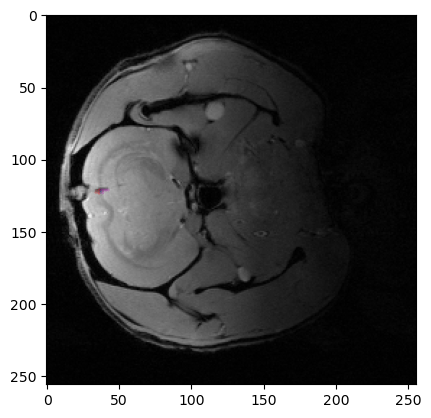

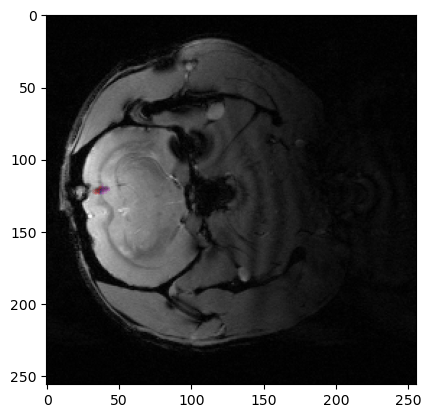

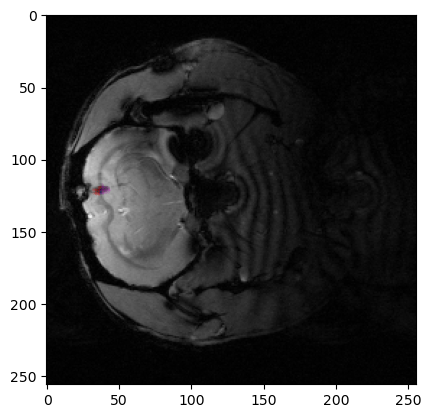

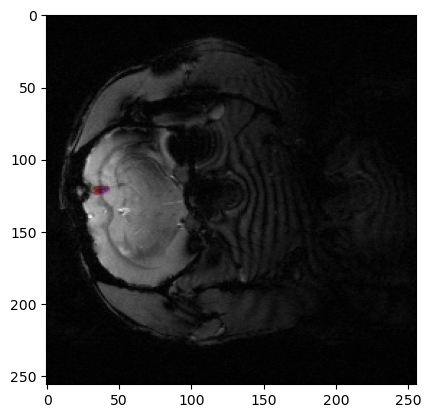

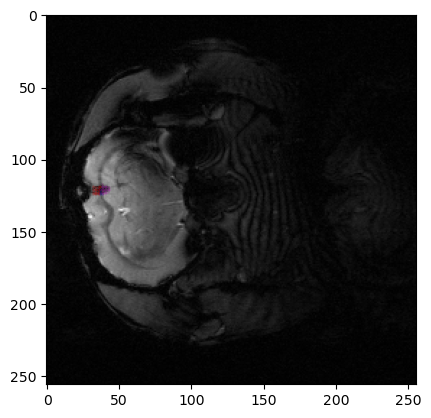

...

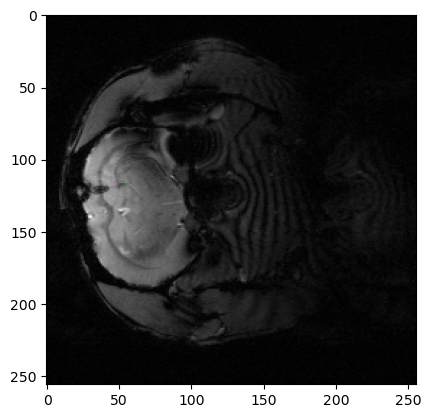

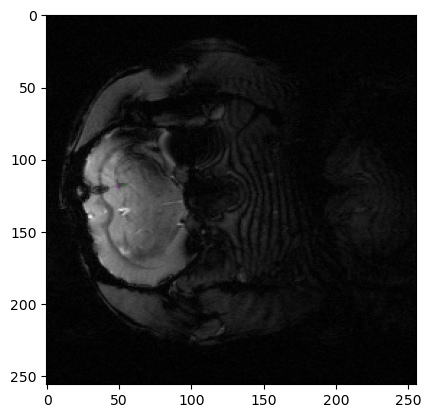

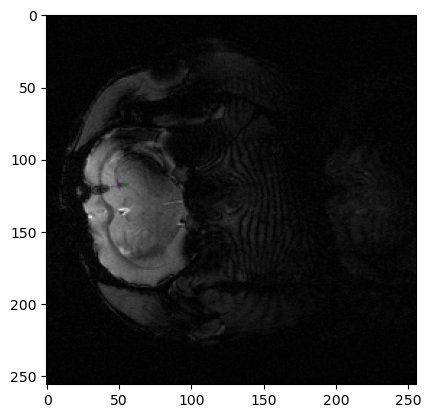

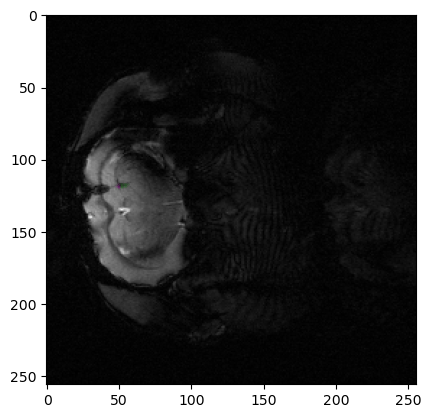

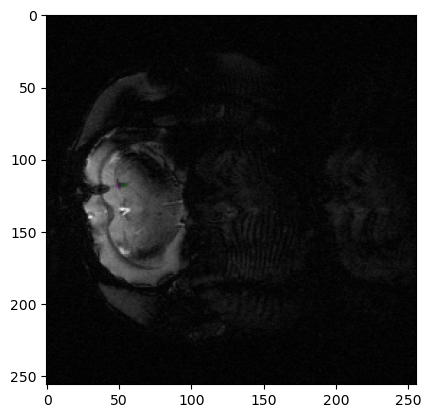

In [424]:
basestruct=["crtx","cc","hpc","fimbria", "thlms"]
segname="duo"
img_slice=3
segmentation_mask=coronal1seg[:,:,img_slice]

# seg_areas=labelsdf["Labels"][labelsdf["Anatomical Regions"]==segname].values
seg_areas=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(segname)]
print("Segment of interest: "+segname+" sitk-label:"+str(seg_areas))
save_path=root+analysed+segname+"-regionspecific/"
dpi=1000
savefigs=False
zthr=-1.95

if not os.path.exists(save_path+"roi/"):
    os.mkdir(save_path+"roi/")

num_echos=coronal1data.shape[-1]

minimas=np.empty((len(seg_areas), num_echos, 2))
avgCenters=np.empty((len(seg_areas), num_echos, 2))
weightedCenters=np.empty((len(seg_areas), num_echos, 2))

px_intensities=[]
ind=[]

masks=np.zeros((len(seg_areas), num_echos, segmentation_mask.shape[0],segmentation_mask.shape[1]))
for j,seg in enumerate(seg_areas):
    tmpvals=[]
    for echo in range(num_echos):
        echovals=[]
        crtxidx=[]
        hpcidx=[]
        thlmsidx=[]
        ccidx=[]
        indx=[]
        xind_w=[]
        xind_coef=[]
        yind_w=[]
        yind_coef=[]
        indy=[]

        img=coronal1data[:,:,img_slice,echo]
        
        minimaTmp=999
        minimIdx=[0,0]
        
        for index in np.array(list(zip(*np.where(segmentation_mask==seg)))):
            base_seg,struct,_,_=get_neigh_basestruct(index, basestruct, labelsdf, segmentation_mask)
            baseline=get_baseline_vals(base_seg, segmentation_mask, coronal1data[:,:,img_slice,:])         
            imgz=img_zscore(img[index[0],index[1]],baseline[:,echo])
            minimaTmp, minimIdx = minima_pixel(img, index, minimaTmp, minimIdx)
            
            if imgz<zthr:
                indx.append(index[1])
                indy.append(index[0])
                xind_w, xind_coef, yind_w, yind_coef= weighted_pixel_index(img, index, xind_w, xind_coef, yind_w, yind_coef)
                
                if struct=="crtx":
                    crtxidx.append(index)
                elif struct =="cc":
                    ccidx.append(index)
                elif struct=="hpc":
                    hpcidx.append(index)
                elif struct=="thlms":
                    thlmsidx.append(index)

                masks[j,echo,index[0],index[1]]=1
                echovals.append(imgz)
                
        
        avgCenters[j,echo,0]=np.mean(indx)
        avgCenters[j,echo,1]=np.mean(indy)

        weightedCenters[j,echo,0]=np.sum(xind_w)/np.sum(xind_coef)
        weightedCenters[j,echo,1]=np.sum(yind_w)/np.sum(yind_coef)
            
        minimas[j,echo,:]=minimIdx   
        
        crtxidx=np.array(crtxidx)
        ccidx=np.array(ccidx)
        hpcidx=np.array(hpcidx)
        thlmsidx=np.array(thlmsidx)

        tmpvals.append(echovals)
        plt.imshow(img, cmap='gray')
        if crtxidx.any():
            plt.scatter(crtxidx[:,1], crtxidx[:,0], c='r', s=0.01)
        if ccidx.any():
            plt.scatter(ccidx[:,1], ccidx[:,0], c='b', s=0.01)
        if hpcidx.any():
            plt.scatter(hpcidx[:,1], hpcidx[:,0], c='m', s=0.01)
        if thlmsidx.any():
            plt.scatter(thlmsidx[:,1], thlmsidx[:,0], c='g', s=0.01)
#         plt.scatter(indy, indx, c='r', s=0.01)
        if savefigs:
            filename=segname+str(seg)+"echo"+str(echo)+".png"
            plt.savefig(save_path+"roi/"+filename, dpi=dpi)
        plt.show()
        
    px_intensities.append(tmpvals)

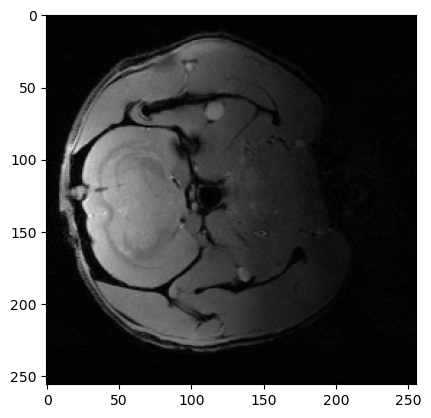

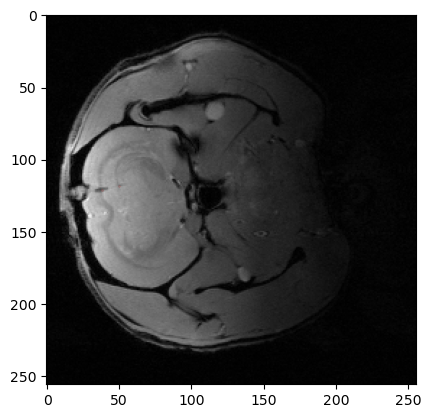

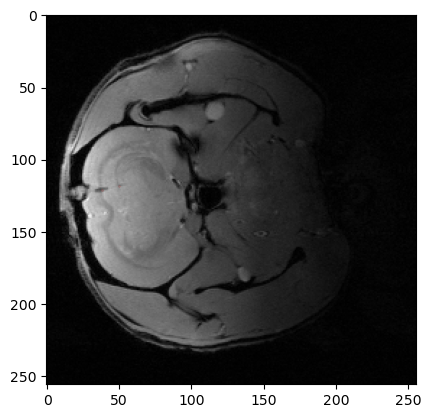

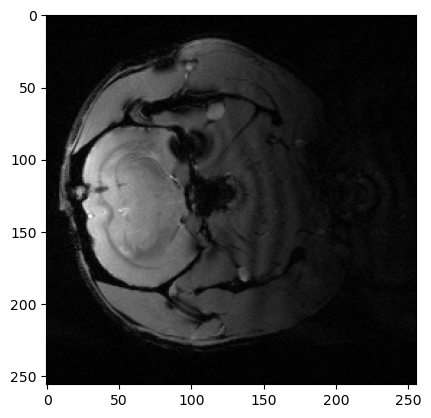

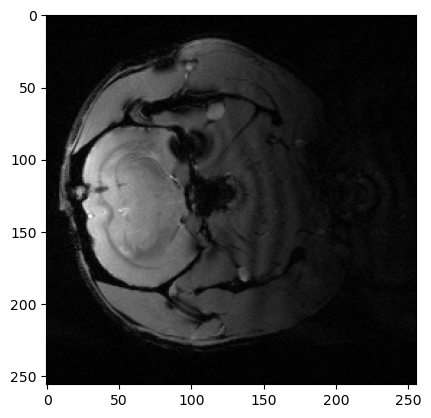

...

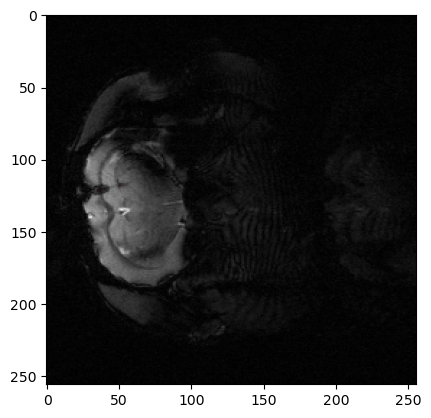

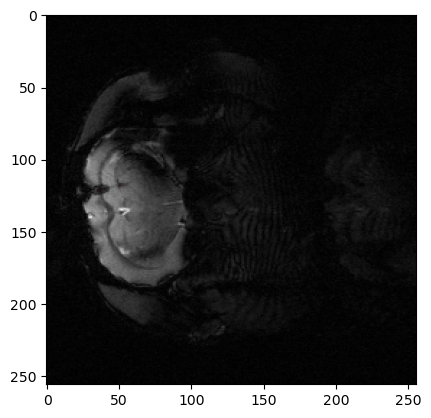

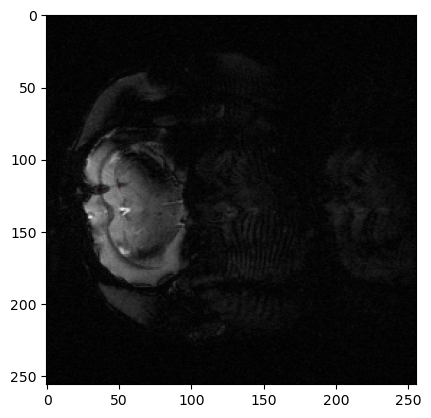

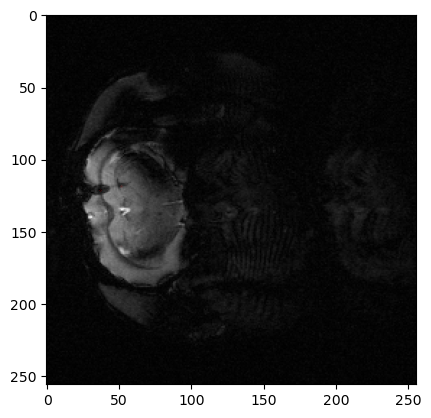

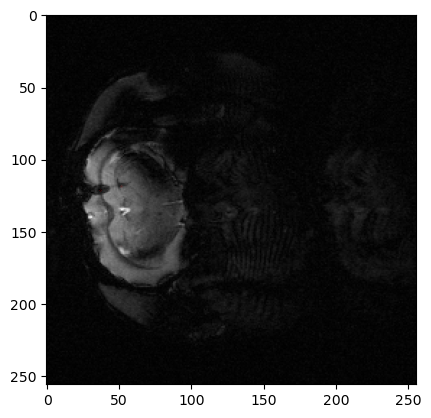

In [299]:
plot_centers(coronal1data[:,:,img_slice,:], 8,"duo", minimas, avgCenters, weightedCenters, save_path)

In [599]:
segment_areas=np.array([10361, 1750])
segment_lengths=np.array([1150,1000])
segment_densities=segment_areas/segment_lengths
print(segment_densities)
duo_segment_densities=segment_densities

[9.00956522 1.75      ]


[0]


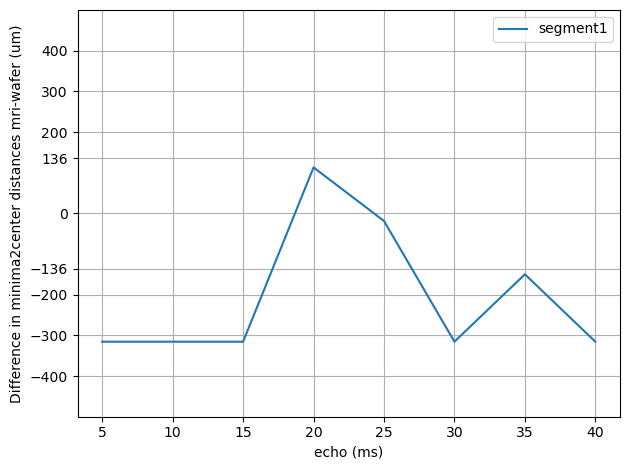

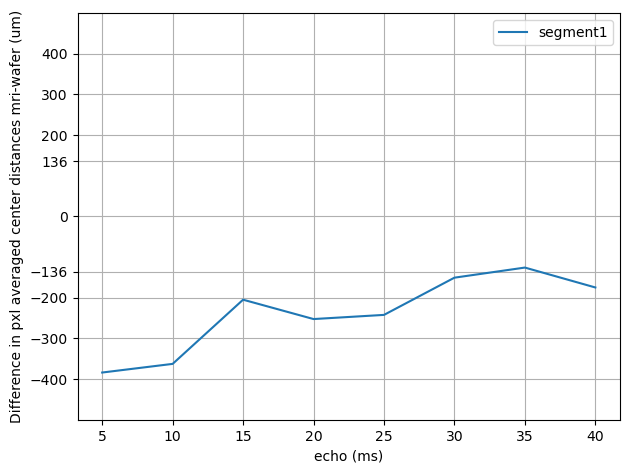

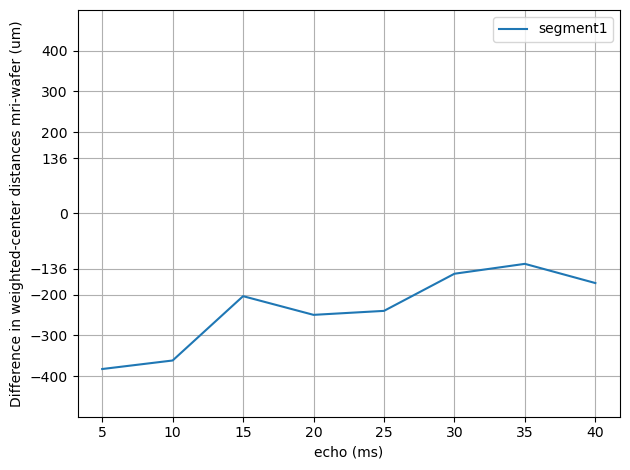

In [426]:
%run utils/plotters.ipynb

d1=segment_lengths[0]
d12=1055
d2=segment_lengths[1]
c2c_dist=np.array([d1/2 + d12 + d2/2])

plot_c2c(c2c_dist,minimas,avgCenters,weightedCenters)

In [427]:
duo_c2c=c2c_dist
duo_weightedCenters=weightedCenters

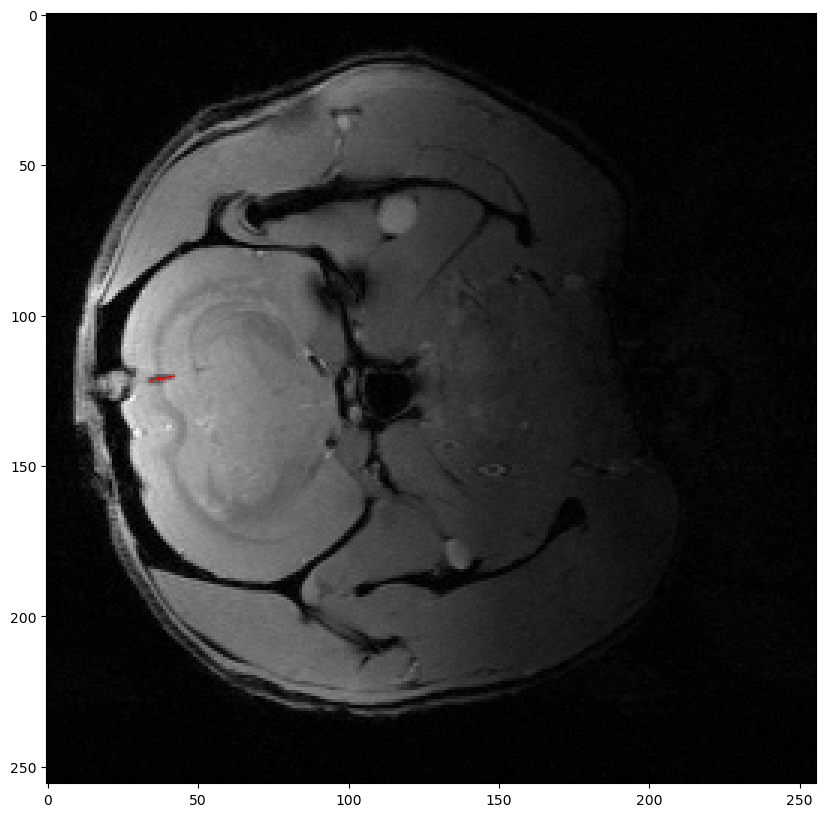

[34 35 36 37 38 39 40 41 42]
[122 121 121 121 121 121 121 120 120]


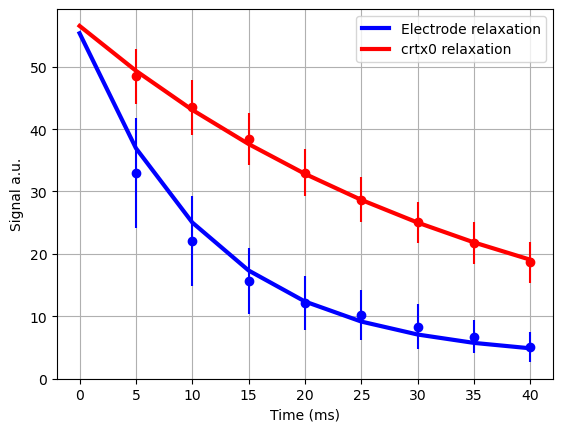

baseline:crtx
t2star tissue: 27.199717331113515
t2star electrode: 87.33845920176411
difference: 60.13874187065059
center: 34,122


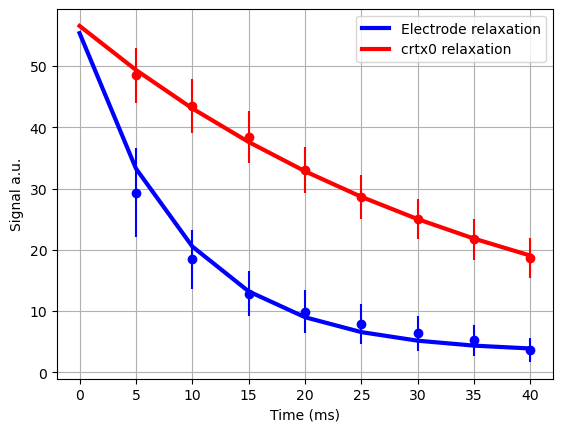

baseline:crtx
t2star tissue: 27.199717331113515
t2star electrode: 110.39706707760604
difference: 83.19734974649252
center: 34,122


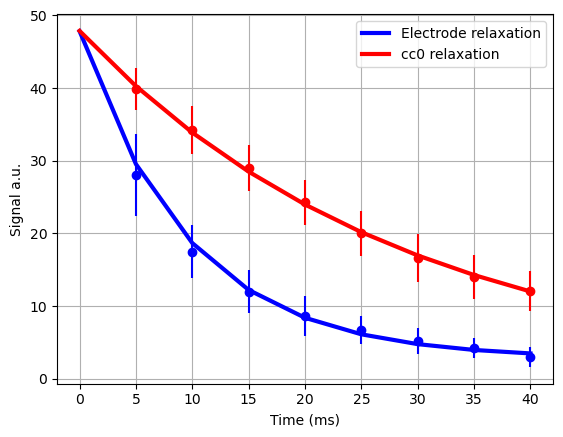

baseline:cc
t2star tissue: 34.57533417256745
t2star electrode: 104.24659562396094
difference: 69.67126145139349
center: 34,122


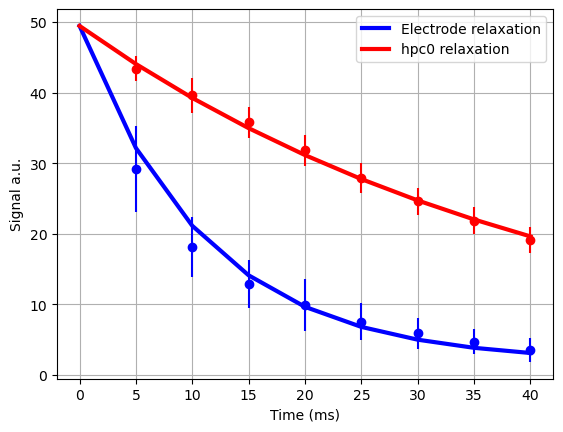

baseline:hpc
t2star tissue: 23.12271710455459
t2star electrode: 90.31382102107513
difference: 67.19110391652055
center: 34,122


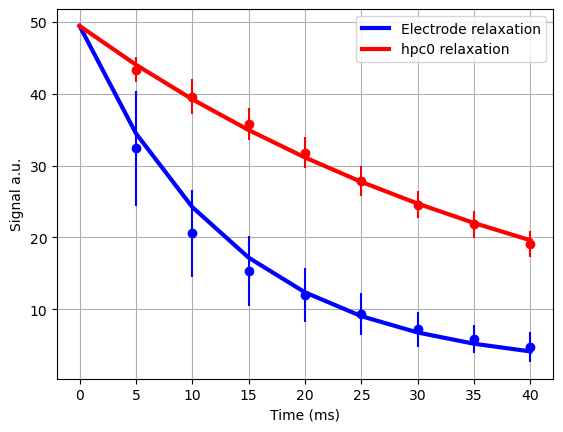

baseline:hpc
t2star tissue: 23.12271710455459
t2star electrode: 75.34046187713281
difference: 52.21774477257822
center: 34,122


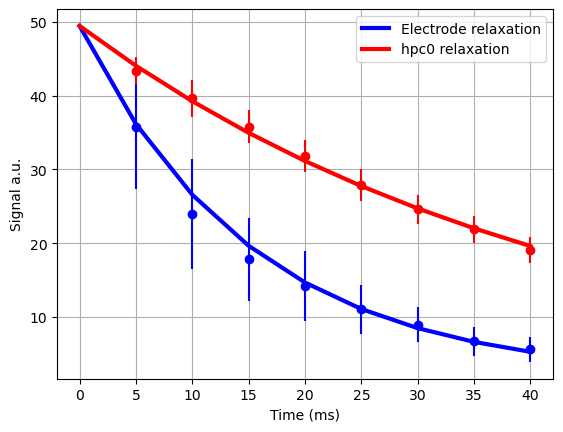

baseline:hpc
t2star tissue: 23.12271710455459
t2star electrode: 65.46346583641098
difference: 42.34074873185639
center: 34,122


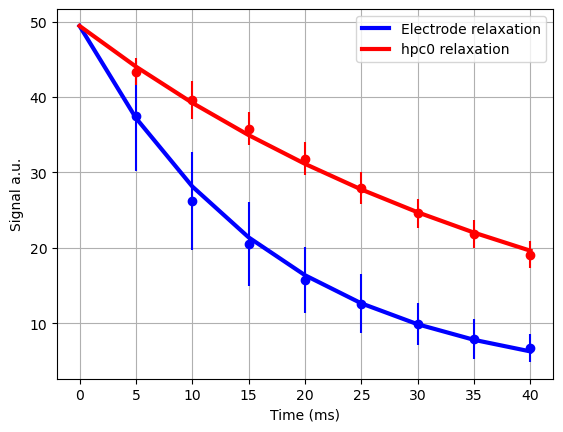

baseline:hpc
t2star tissue: 23.12271710455459
t2star electrode: 59.280249066467256
difference: 36.15753196191267
center: 34,122


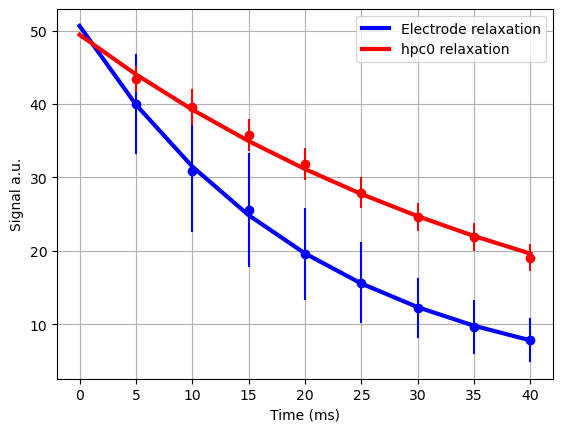

baseline:hpc
t2star tissue: 23.12271710455459
t2star electrode: 48.113867991101415
difference: 24.991150886546826
center: 34,122
[60.13874187065059, 83.19734974649252, 69.67126145139349, 67.19110391652055, 52.21774477257822, 42.34074873185639, 36.15753196191267, 24.991150886546826]


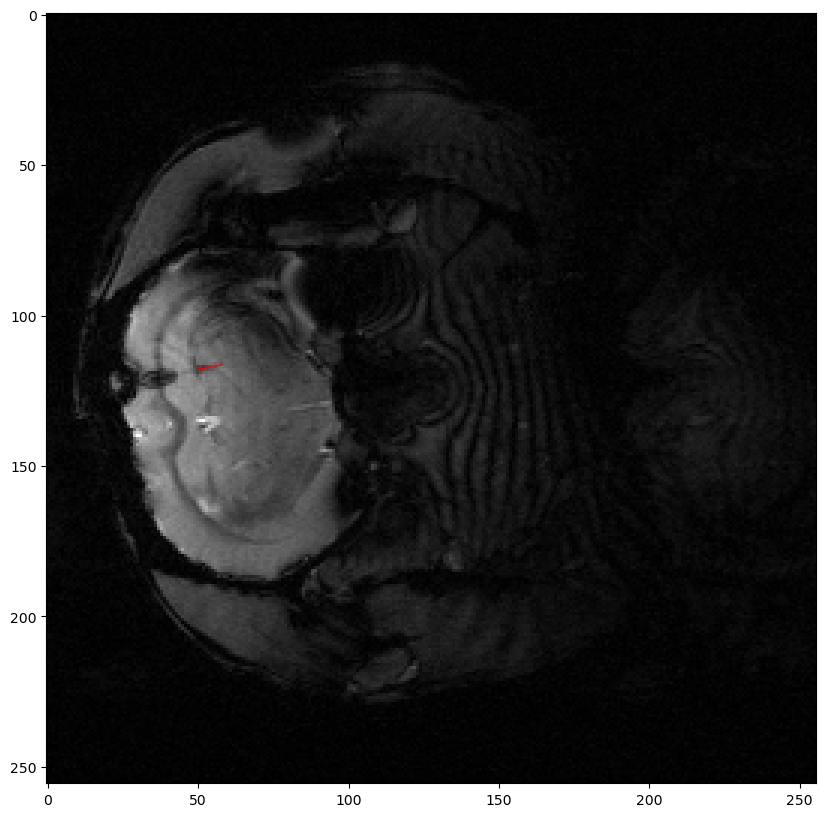

[50 51 52 53 54 55 56 58]
[118 118 118 117 117 117 117 116]


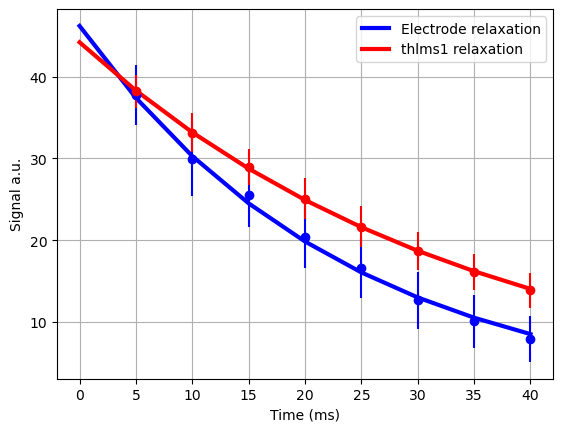

baseline:thlms
t2star tissue: 28.668078835257663
t2star electrode: 42.27152773833345
difference: 13.603448903075783
center: 51,118


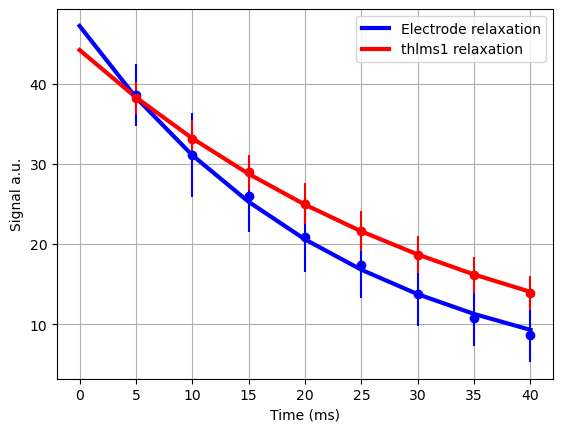

baseline:thlms
t2star tissue: 28.668078835257663
t2star electrode: 42.928596755466906
difference: 14.260517920209242
center: 51,118


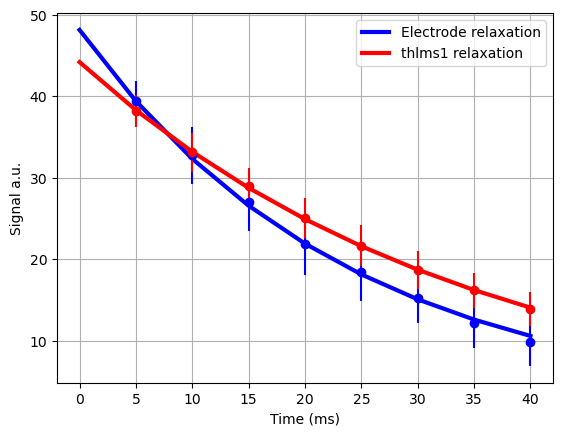

baseline:thlms
t2star tissue: 28.668078835257663
t2star electrode: 41.98588303339737
difference: 13.317804198139708
center: 51,118


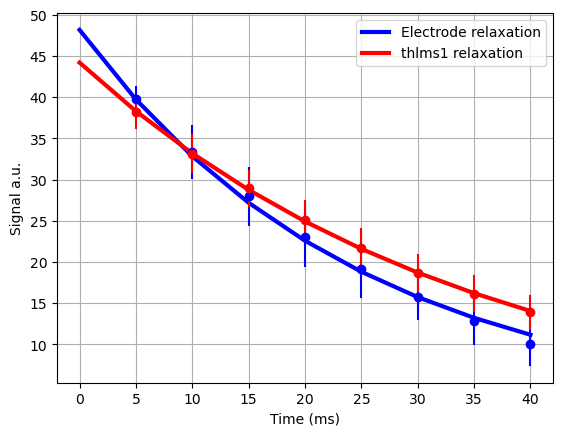

baseline:thlms
t2star tissue: 28.668078835257663
t2star electrode: 40.37394431048241
difference: 11.705865475224744
center: 51,118


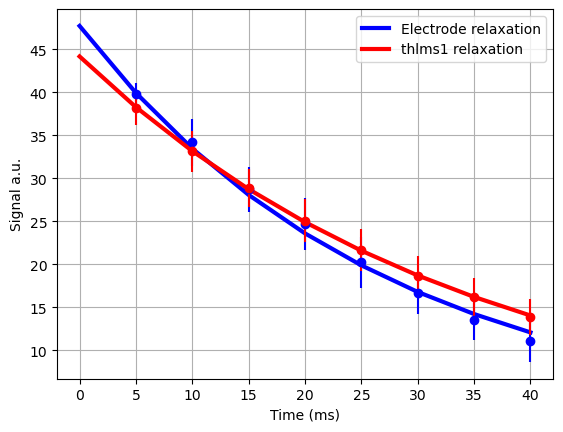

baseline:thlms
t2star tissue: 28.668078835257663
t2star electrode: 36.98521964096811
difference: 8.317140805710448
center: 51,118


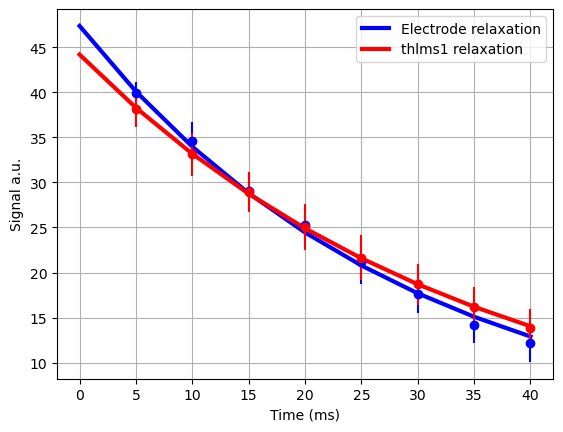

baseline:thlms
t2star tissue: 28.668078835257663
t2star electrode: 34.27853375126912
difference: 5.610454916011459
center: 51,118


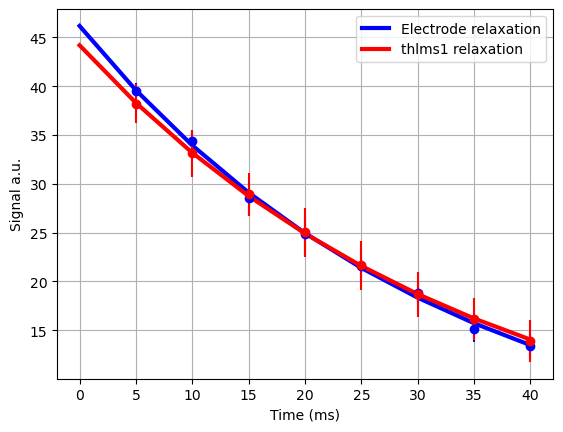

baseline:thlms
t2star tissue: 28.668078835257663
t2star electrode: 30.795591124742668
difference: 2.1275122894850043
center: 51,118


In [81]:
echos=[0,4]

numMinsArr=[20,15]
segmentation_mask=coronal1seg[:,:,img_slice]
t2diffDuo0=[]
t2diffDuo1=[]
bundleLen0=[]
bundleLen1=[]

for i, segment in enumerate(seg_areas):
    pxIdxValsSorted=get_sorted_pxls(coronal1data[:,:,img_slice,echos[i]], coronal1seg[:,:,img_slice], segment)
    # def linefit(pxIdxValsSorted, numMins=40, d=1, save_path="", filename=""):
    numMins=numMinsArr[i]
    d=1
    z=np.polyfit(pxIdxValsSorted[:numMins,1], pxIdxValsSorted[:numMins,0], d)
    img=coronal1data[:,:,img_slice,echos[i]]
    plt.figure(figsize=(10,10))
    plt.imshow(img,cmap='gray')
    plt.scatter(pxIdxValsSorted[:numMins,1], pxIdxValsSorted[:numMins,0], c='r', s=0.01)
    plt.plot(pxIdxValsSorted[:numMins,1], pxIdxValsSorted[:numMins,1]*z[0]+z[1], c='r', linewidth=0.5)
    filename="duo"+str(segment)+"_linefit.png"
    if save_path and filename:
        plt.savefig(save_path+filename, dpi=1000)
    plt.show()
    
    x=np.sort(pxIdxValsSorted[:numMins,1])
#     x=np.sort(x)
    onset=0
    offset=5
    start=2
    x=np.unique(x)
#     x=np.linspace(x[start]-onset, x[-1]+offset, int(x[-1]+offset-x[start]+onset+1))
    y=np.round(x*z[0]+z[1]).astype(int)
    x=x.astype(int)
#     x=np.round(np.linspace(x[start]-onset, x[-1]+offset, int(x[-1]+offset-x[start]+onset+1))).astype(int)
    print(x)
    print(y)
    
    basestructs=["crtx", "cc", "hpc", "thlms"]
 
    t2diffDuo=[]
    bundleLen=[]
    for j in range(len(x)):
        if j==0:
            p0=np.array([y[j],x[j]])
        else:
            base_seg,struct,_,_=get_neigh_basestruct([y[j],x[j]], basestructs, labelsdf, segmentation_mask)
            baseline=get_baseline_vals(img_slice, base_seg, coronal1seg, coronal1data)
            paramsBase, paramsData, _, _=relaxation_fixedROI(coronal1data[:,:,img_slice,:],[y[j],x[j]],elecSegment='duo',baseline=baseline, r=2, savepath=save_path, baseName=struct+str(i))
        #     if i%3==0:
            print("baseline:"+struct)
            print("t2star tissue: "+str(1000/paramsBase[1]))
            print("t2star electrode: "+str(1000/paramsData[1]))
            print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
            print("center: "+ str(x[i])+","+str(y[i]))
            t2diffDuo.append(1000/paramsData[1]-1000/paramsBase[1])
            p1=np.array([y[j],x[j]])
            bundleLen.append(np.linalg.norm(p1-p0)*136)
    if i==0:
        print(t2diffDuo)
        t2diffDuo0=t2diffDuo
        bundleLen0=bundleLen
#         plt.plot(bundleLen, t2diffDuo)
    else:
        t2diffDuo1=t2diffDuo
        bundleLen1=bundleLen
#         plt.plot(np.flip(bundleLen)/50*0.18, t2diffDuo)
        #     t2diff.append(1000/paramsData[1]-1000/paramsBase[1])

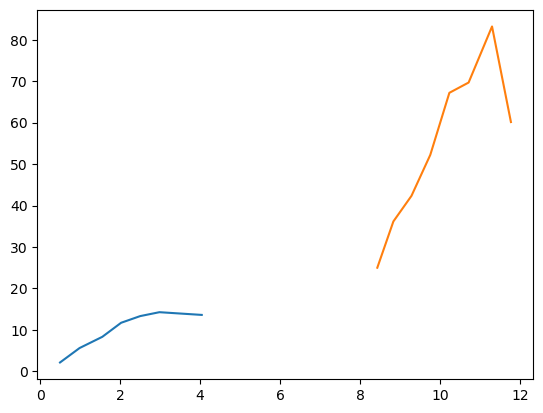

In [203]:
plt.plot(np.flip(bundleLen1)/50*0.18, t2diffDuo1)
plt.plot((np.flip(bundleLen0)/50+43)*0.18, t2diffDuo0)

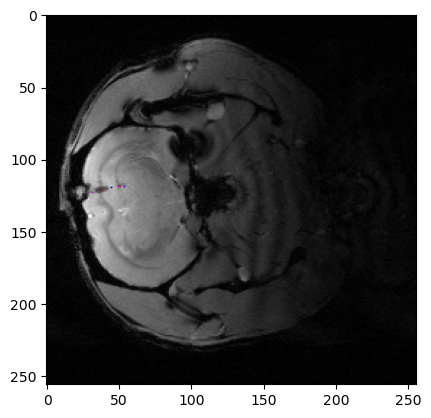

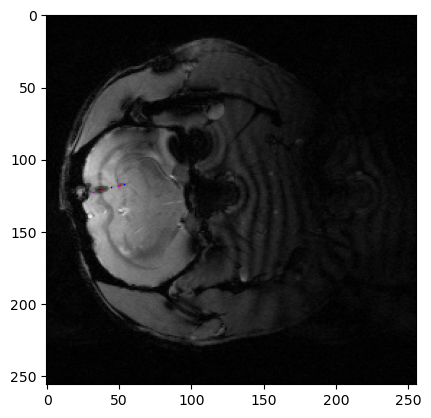

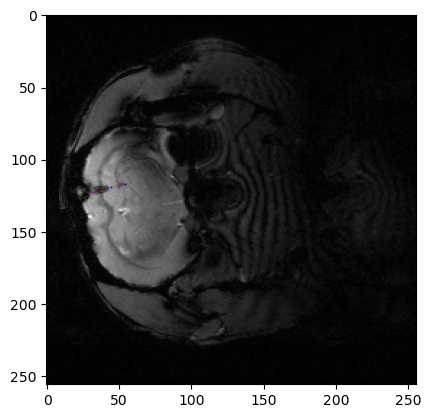

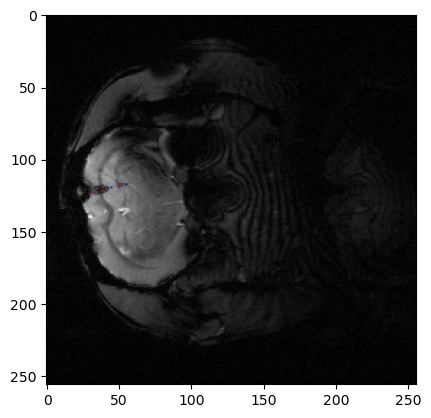

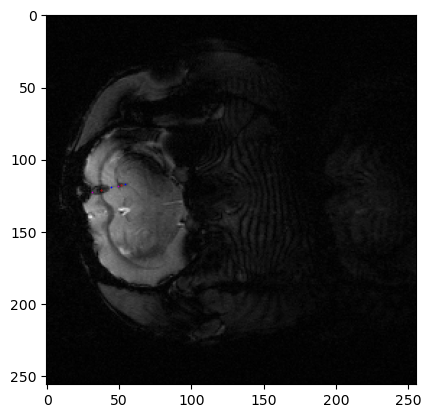

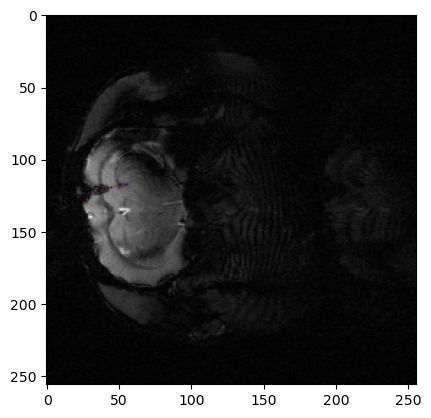

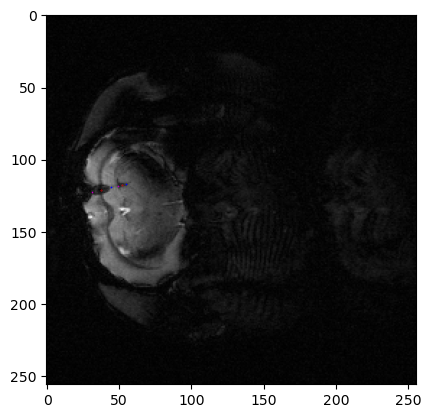

In [190]:
%run geometry_utils.ipynb

pattern_lengths=np.empty((num_echos, 2))
for echo in range(1,num_echos):
    farp, closep = get_endpoints(coronal1data, seg_areas, weightedCenters, masks, echo, save_path, filename="duo")
    pattern_lengths[echo,:]=np.transpose(np.linalg.norm(farp-closep, axis=1)*136)
    

# plt.plot(segment_densities,np.mean(pattern_lengths, axis=0))
# plt.figure()
# plt.plot(segment_densities,np.mean(px_count, axis=1))

[121  37]


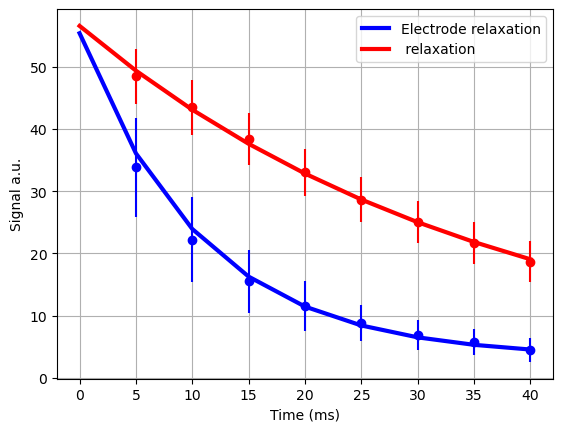

Pattern 0
t2star tissue: 27.199717331113515
t2star electrode: 92.56828360147175
difference: 65.36856627035823
[118  52]


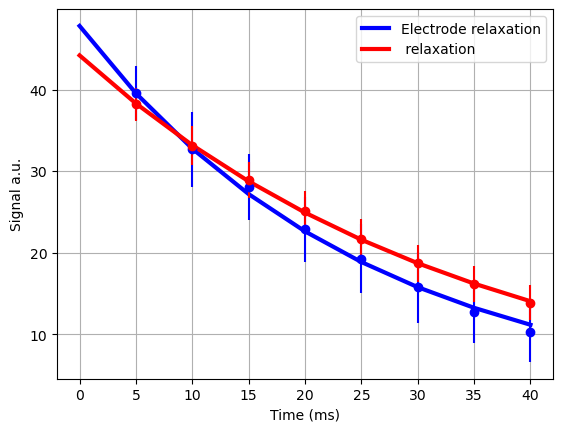

Pattern 0
t2star tissue: 28.668078835257663
t2star electrode: 39.435943476274076
difference: 10.767864641016413


In [79]:
baseName="cc"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_cc=get_baseline_vals(img_slice, base_seg, coronal1seg, coronal1data)   

baseName="crtx"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_crtx=get_baseline_vals(img_slice, base_seg, coronal1seg, coronal1data)    

baseName="thlms"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_thlms=get_baseline_vals(img_slice, base_seg, coronal1seg, coronal1data)

baseName="hpc"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_hpc=get_baseline_vals(img_slice, base_seg, coronal1seg, coronal1data)


t2diffDuo=[]
i=0   
r=3
print((np.round(np.flip(weightedCenters[i,-1,:]))).astype(int))
paramsBase, paramsData, _, _=relaxation_fixedROI(coronal1data[:,:,img_slice,:], (np.round(np.flip(weightedCenters[i,-1,:]))).astype(int), i, base_crtx, r=r, savepath=save_path)
print("Pattern 0")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
t2diffDuo.append(1000/paramsData[1]-1000/paramsBase[1])


i=1
r=3
print((np.round(np.flip(weightedCenters[i,-1,:]))).astype(int))
paramsBase, paramsData, _, _=relaxation_fixedROI(coronal1data[:,:,img_slice,:], (np.round(np.flip(weightedCenters[i,-1,:]))).astype(int), i, base_thlms, r=r, savepath=save_path)
print("Pattern 0")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
t2diffDuo.append(1000/paramsData[1]-1000/paramsBase[1])

In [305]:
duo_t2s_diff=np.flip(np.array([10.76786, 65.3685]))
duo_segment_density=segment_densities
print(duo_segment_density)

[9.00956522 1.75      ]


# rEO_08 coronal2_slice:3, quad-zone pattern

In [748]:
path="/Users/eminhanozil/Dropbox (Yanik Lab)/Localization Manuscript 2024/RAT DATA/rEO_08/mri-raw/bids/sub-rEO_08/ses-postsurgery20240502/anat/sub-rEO_08_ses-postsurgery20240502_task-coronal2_acq-T2starMapMGE_T2w-ind_10.nii.gz"
pathseg="/Users/eminhanozil/Dropbox (Yanik Lab)/Localization Manuscript 2024/RAT DATA/rEO_08/mri-raw/bids/sub-rEO_08/ses-postsurgery20240502/anat/rEO_08-coronal2-t2sMGE-segmentation.nii.gz"

_, coronal2=read_data(path)
_, coronal2seg=read_data(pathseg)
labelspath="rEO_08-coronal2-t2sMGE-labels.txt"
labelsdf=read_labels(root+bids+labelspath)
%run utils/preprocessing.ipynb
%run utils/geometry.ipynb
%run utils/plotters.ipynb

In [749]:
%run utils/geometry.ipynb

path=root+analysed
img_slice=3
segmentation=coronal2seg[:,:,img_slice]
data=coronal2[:,:,img_slice,:]
roi_name="quad"
basestructs=["crtx", "deepTissue"]
quadDict,_=find_roi(data, segmentation, basestructs, labelsdf, roi_name, path,path_extension="-2", savefigs=False)

basestructs=["crtx", "CC", "deepTissue"]
quadDictCC,_=find_roi(data, segmentation, basestructs, labelsdf, roi_name, path,path_extension="-2", savefigs=False)

Segment of interest: quad sitk-label:3    4
4    5
5    6
6    7
Name: Labels, dtype: int64
numechos:8
Segment of interest: quad sitk-label:3    4
4    5
5    6
6    7
Name: Labels, dtype: int64
numechos:8


<IPython.core.display.Javascript object>


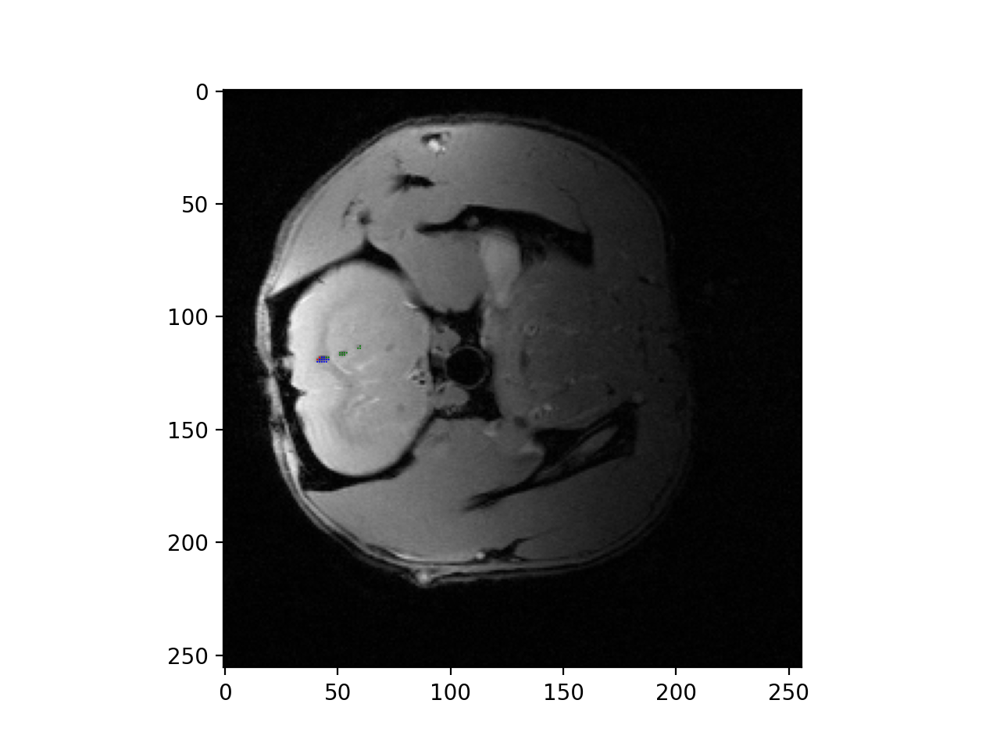

<IPython.core.display.Javascript object>


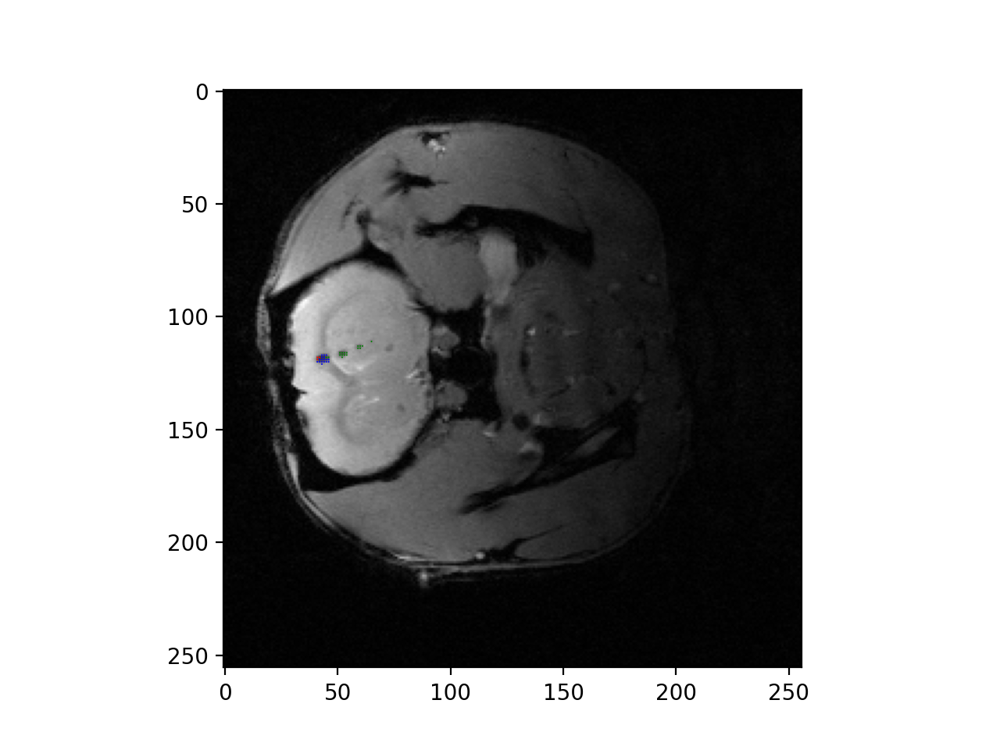

<IPython.core.display.Javascript object>


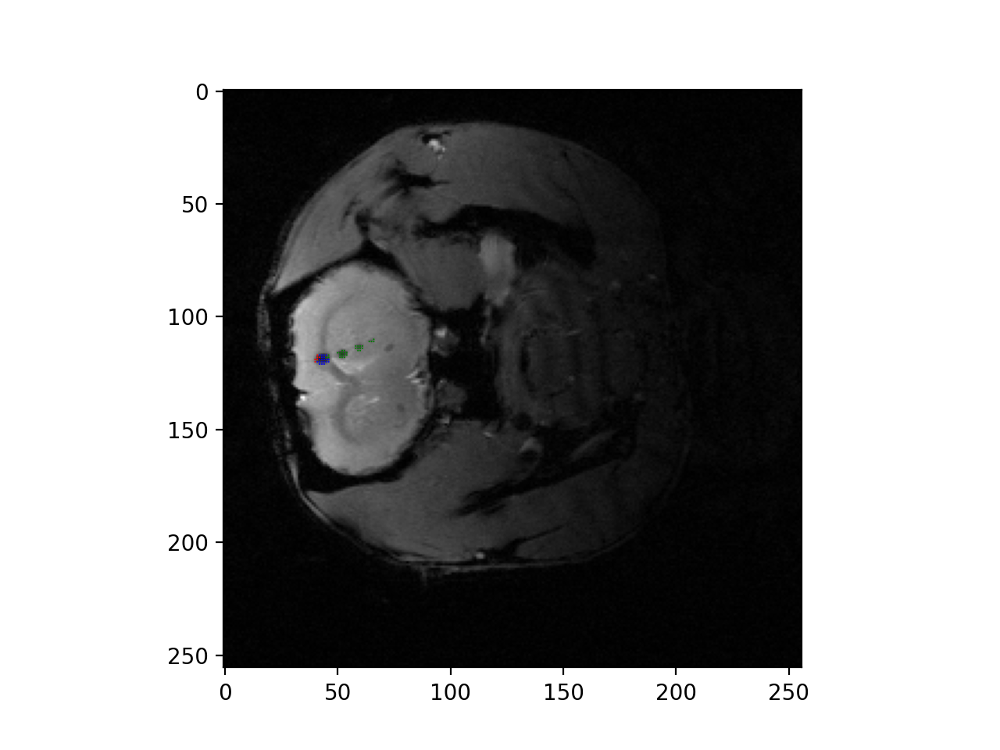

<IPython.core.display.Javascript object>


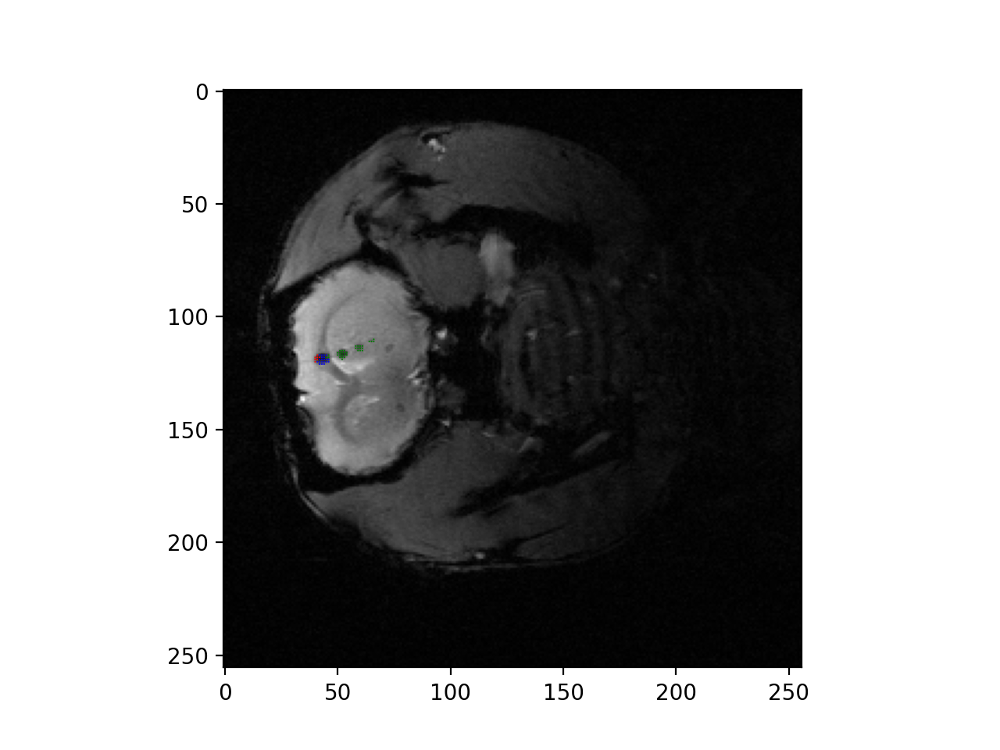

<IPython.core.display.Javascript object>


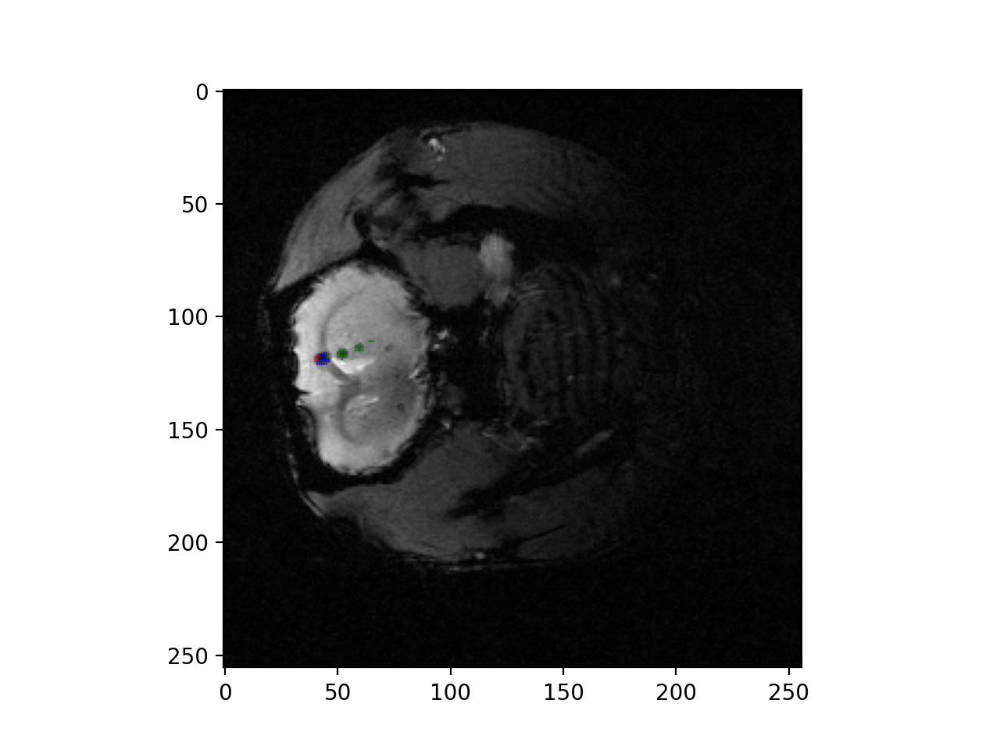

<IPython.core.display.Javascript object>


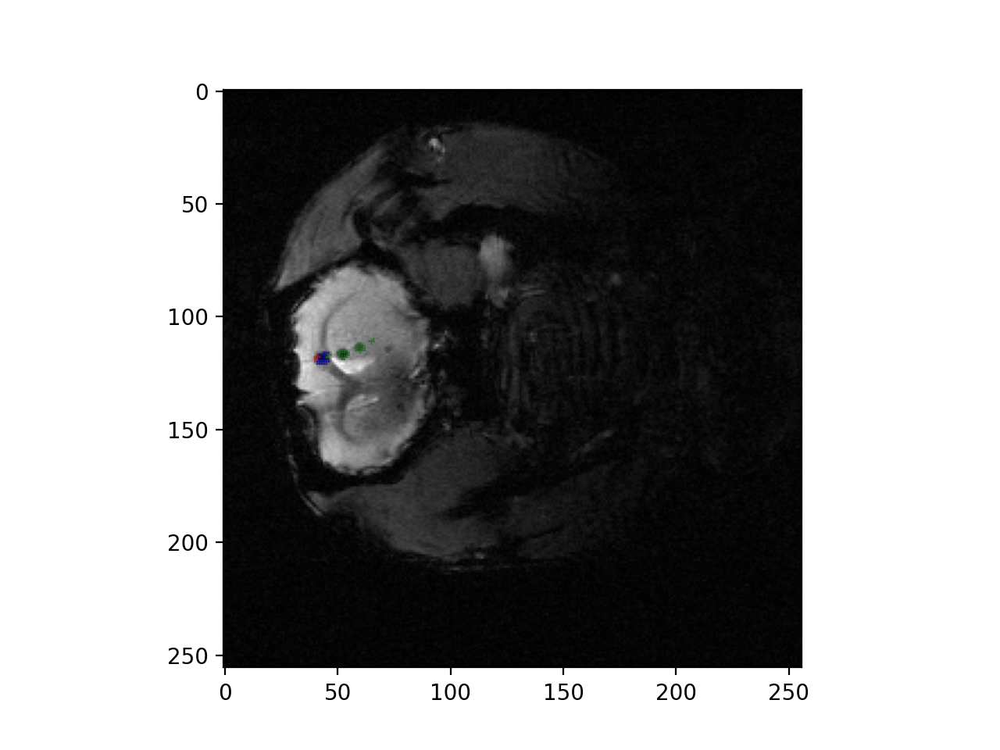

<IPython.core.display.Javascript object>


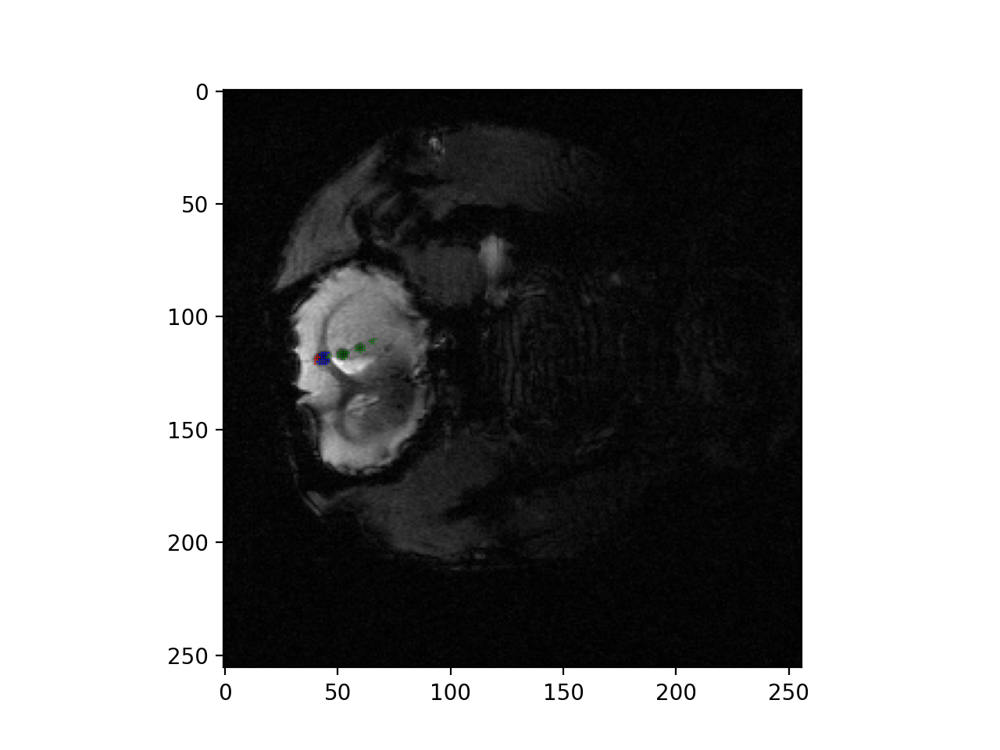

<IPython.core.display.Javascript object>


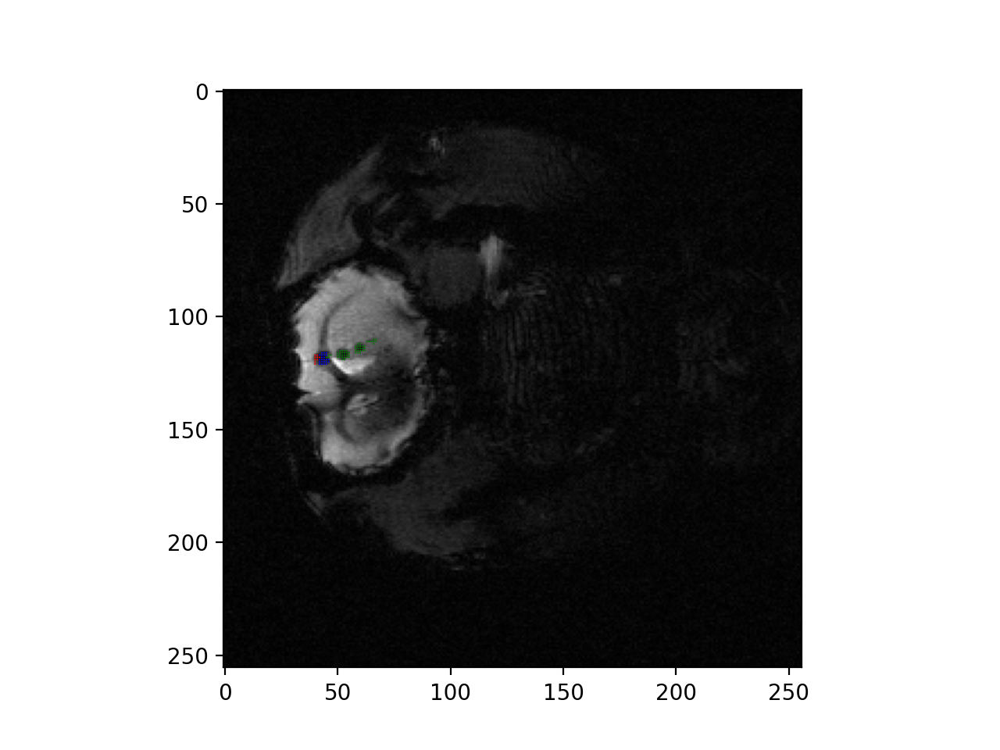

In [769]:
%run utils/plotters.ipynb
path=root+analysed
roi_name="quad"
img_slice=3
data=coronal2[:,:,img_slice,:]

save_path=root+analysed+roi_name+"-regionspecific/roi-3/"
if not os.path.exists(save_path):
    os.mkdir(save_path)
    
plot_all_roi(data, quadDictCC, roi_name, save_path, savefigs=True, dpi=3000)

<IPython.core.display.Javascript object>


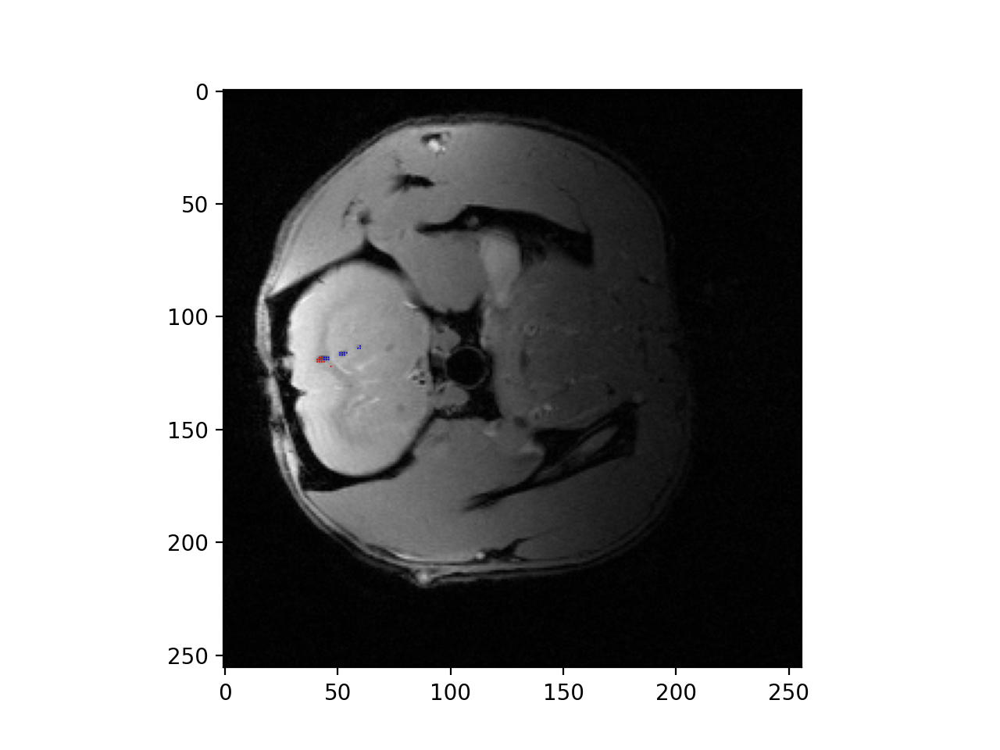

<IPython.core.display.Javascript object>


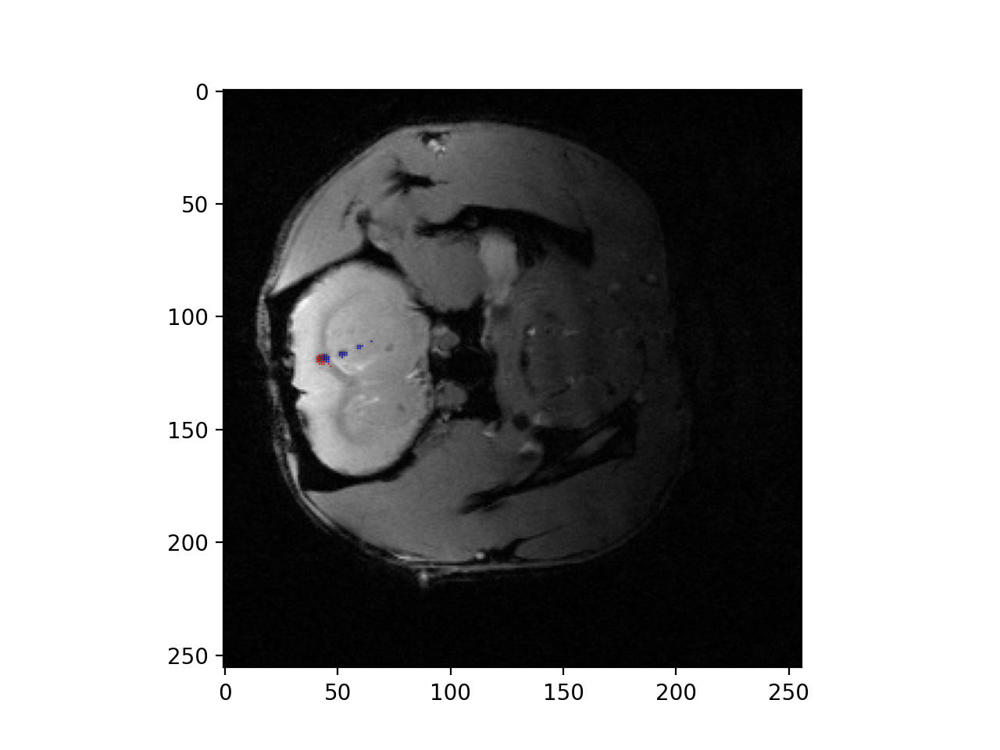

<IPython.core.display.Javascript object>


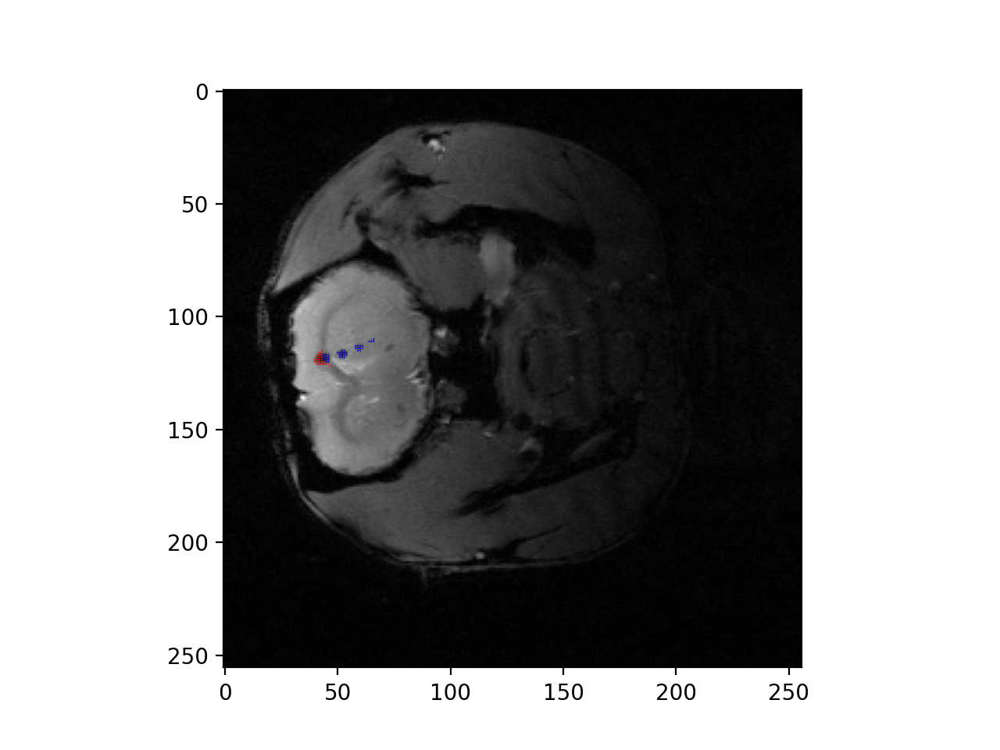

<IPython.core.display.Javascript object>


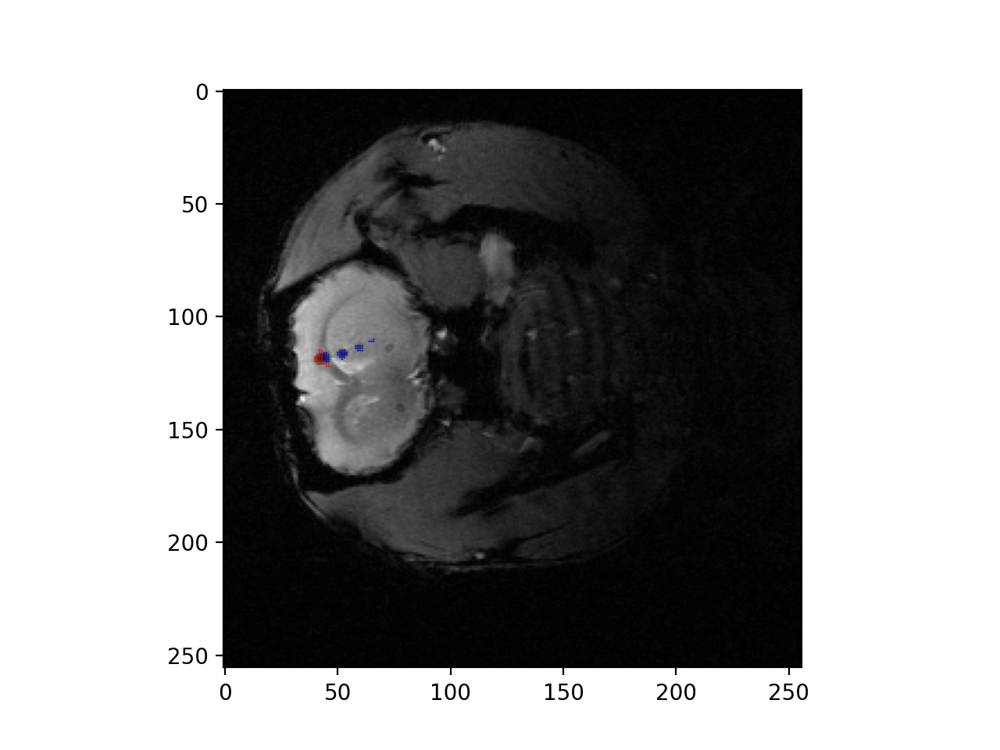

<IPython.core.display.Javascript object>


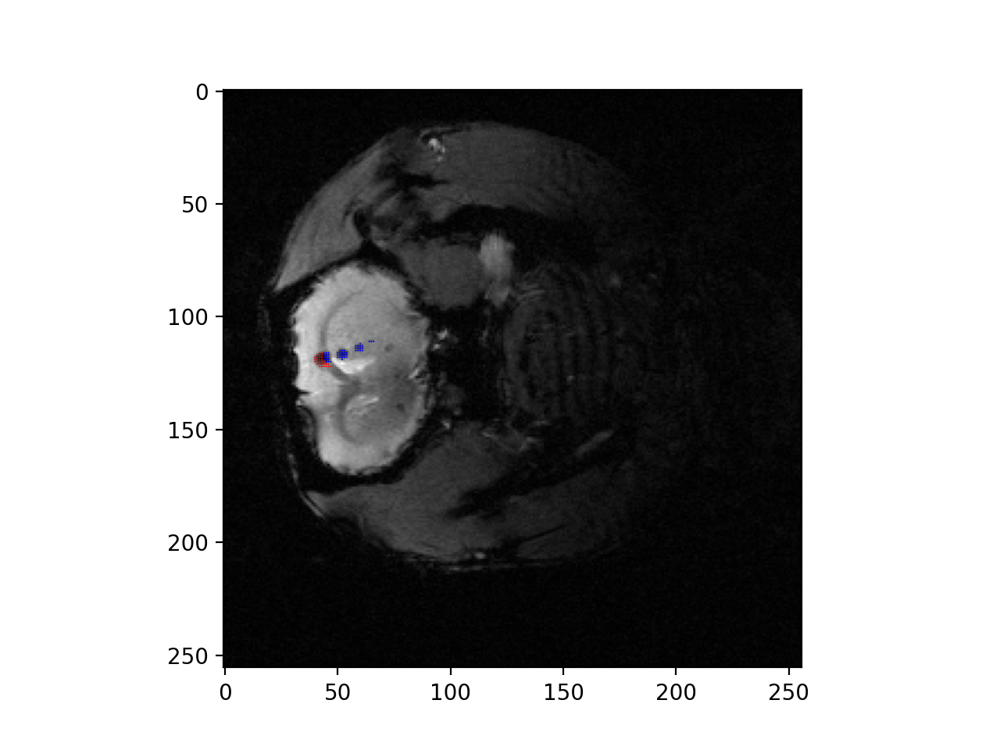

<IPython.core.display.Javascript object>


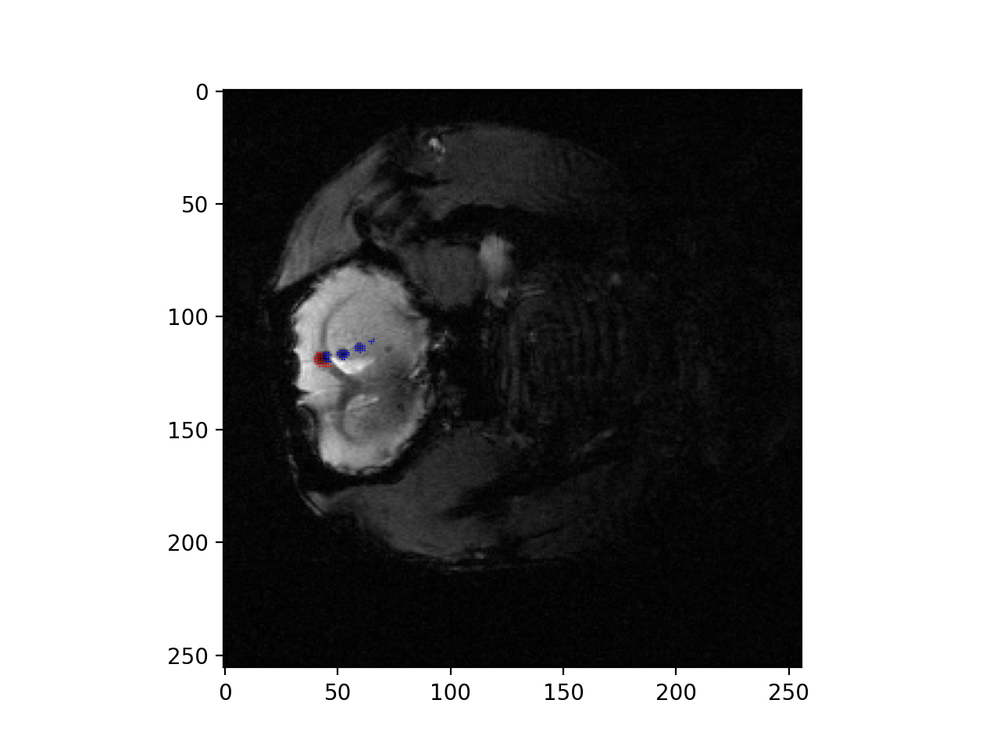

<IPython.core.display.Javascript object>


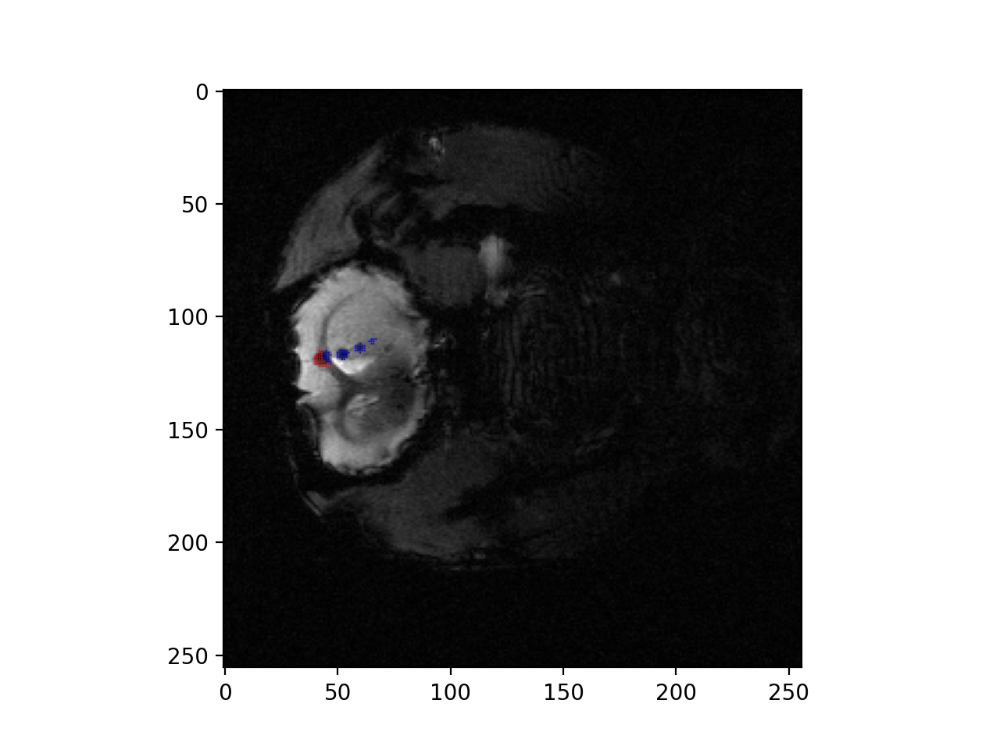

<IPython.core.display.Javascript object>


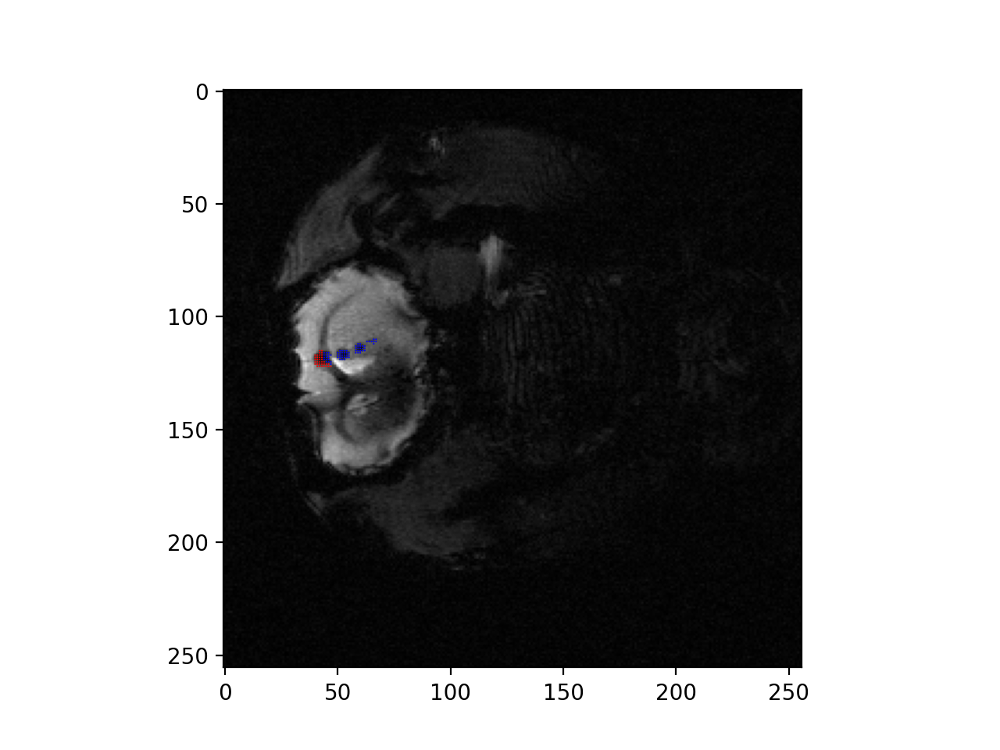

In [770]:
%run utils/plotters.ipynb
path_extension="-2"
path=root+analysed
save_path=path+roi_name+"-regionspecific/"+"roi"+path_extension+"/"
plot_all_roi(data, quadDict, roi_name, save_path, savefigs=True, dpi=3000)

In [717]:
segment_areas=np.flip([175,1075,2170,7118])
segment_lengths=np.array([670, 300, 295, 295])
segment_densities=segment_areas/segment_lengths
print(segment_densities)
quad_areas=segment_areas
quad_segment_densities=segment_densities

[10.6238806   7.23333333  3.6440678   0.59322034]


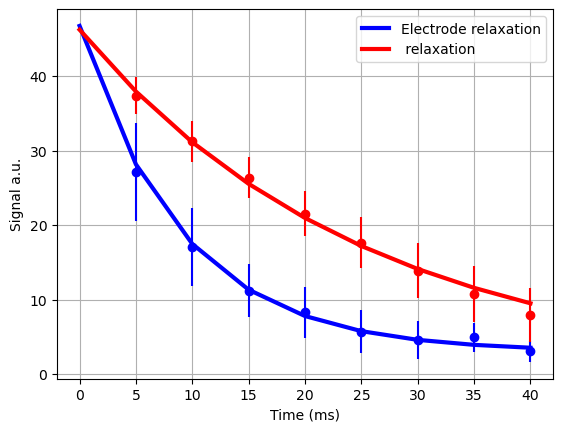

Pattern 0
t2star tissue: 39.58071223719814
t2star electrode: 110.72660388810674
difference: 71.1458916509086


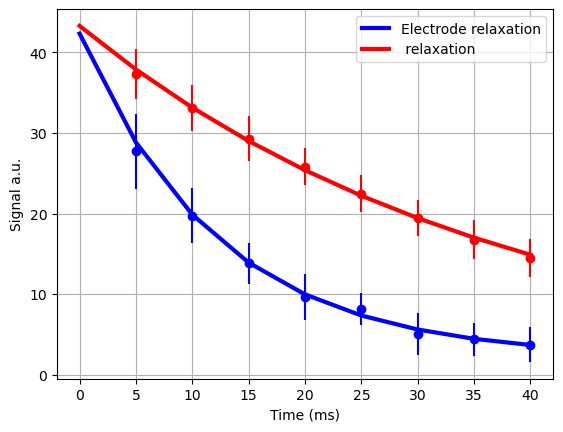

Pattern 1
t2star tissue: 26.70065993616255
t2star electrode: 82.02368626580187
difference: 55.32302632963932


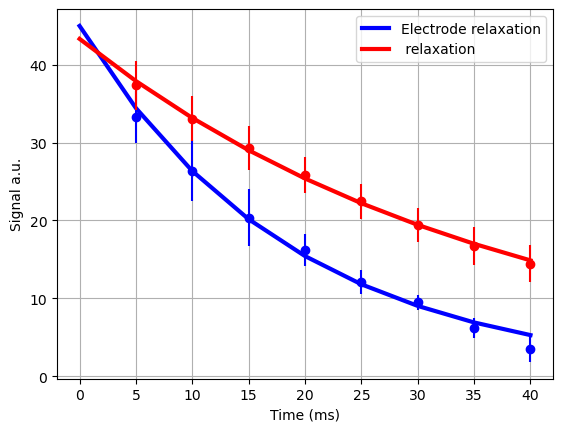

Pattern 2
t2star tissue: 26.70065993616255
t2star electrode: 53.465007769196696
difference: 26.764347833034147


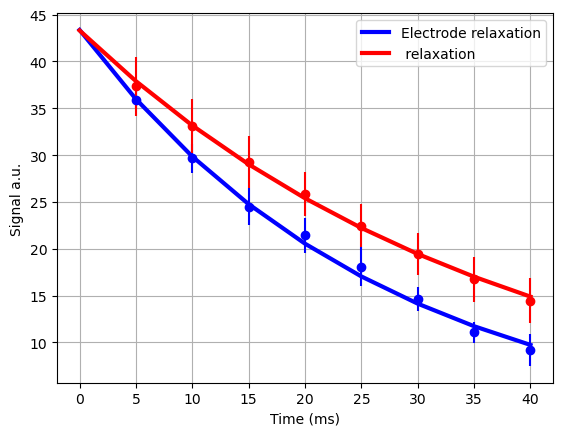

Pattern 3
t2star tissue: 26.70065993616255
t2star electrode: 37.3646842023666
difference: 10.664024266204049


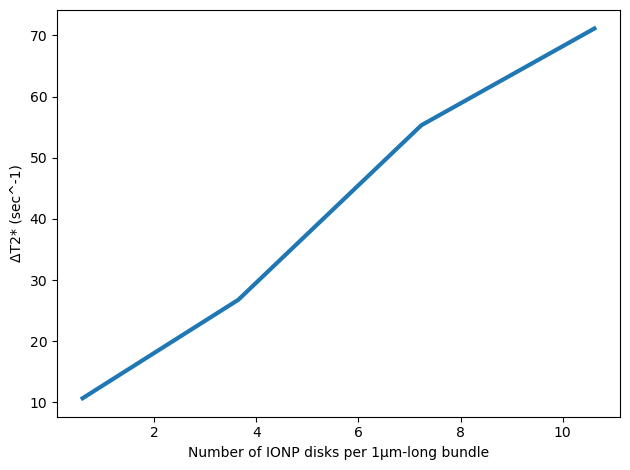

In [318]:
baseName="CC"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_cc=get_baseline_vals(base_seg, segmentation_mask, coronal2[:,:,img_slice,:])   

baseName="crtx"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_crtx=get_baseline_vals(base_seg, segmentation_mask, coronal2[:,:,img_slice,:])    

baseName="deepTissue"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_deep=get_baseline_vals(base_seg, segmentation_mask, coronal2[:,:,img_slice,:])  


segment_lengths=np.array([670, 300, 295, 295])
t2diff=[]
baselines=["cc"]

# for elecSegment in range(4):
elecSegment=0
r=int(np.round(segment_lengths/136/2)[elecSegment])
paramsBase, paramsData, _, _=relaxation_fixedROI(coronal2[:,:,img_slice,:],
                                                 (np.round(np.flip(weightedCenters[elecSegment,-1,:]))).astype(int),
                                                 elecSegment, base_cc, r=r)

print("Pattern "+str(elecSegment))
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
t2diff.append(1000/paramsData[1]-1000/paramsBase[1])


elecSegment=1
r=int(np.round(segment_lengths/136/2)[elecSegment])
paramsBase, paramsData, _, _=relaxation_fixedROI(coronal2[:,:,img_slice,:],
                                                 (np.round(np.flip(weightedCenters[elecSegment,-1,:]))).astype(int),
                                                 elecSegment,
                                                 base_deep,r=r)
print("Pattern 1")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
t2diff.append(1000/paramsData[1]-1000/paramsBase[1])


elecSegment=2
r=int(np.round(segment_lengths/136/2)[elecSegment])

paramsBase, paramsData, _, _=relaxation_fixedROI(coronal2[:,:,img_slice,:],
                                                 (np.round(np.flip(weightedCenters[elecSegment,-1,:]))).astype(int),
                                                 elecSegment,
                                                 base_deep,r=r)
print("Pattern 2")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
t2diff.append(1000/paramsData[1]-1000/paramsBase[1])


elecSegment=3
r=int(np.round(segment_lengths/136/2)[elecSegment])

paramsBase, paramsData, _, _=relaxation_fixedROI(coronal2[:,:,img_slice,:],
                                                 (np.round(np.flip(weightedCenters[elecSegment,-1,:]))).astype(int),
                                                 elecSegment, base_deep,r=r)
print("Pattern 3")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
print("difference: "+str(1000/paramsData[1]-1000/paramsBase[1]))
t2diff.append(1000/paramsData[1]-1000/paramsBase[1])

t2diffQuad=t2diff
quad_segment_densities=segment_densities
plt.figure()
plt.plot(segment_densities, t2diffQuad, linewidth=3)
plt.ylabel("ΔT2* (sec^-1)")
plt.xlabel("Number of IONP disks per 1µm-long bundle")
plt.tight_layout()
# plt.savefig(save_path+"relaxation_vs_density.pdf")

In [420]:
c2c_dist = [((670/2)+750+(300/2)), ((300/2)+755+(300/2)), ((300/2)+600+(300/2))]
quad_c2c=c2c_dist
quad_weightedCenters=weightedCenters
# plot_centers(coronal2[:,:,img_slice,:], 8, minimas, avgCenters, weightedCenters)

# rEO_08 Trizone

In [760]:
path="/Users/eminhanozil/Dropbox (Yanik Lab)/Localization Manuscript 2024/RAT DATA/rEO_08/mri-raw/bids/sub-rEO_08/ses-postsurgery20240502/anat/sub-rEO_08_ses-postsurgery20240502_task-coronal2_acq-T2starMapMGE_T2w-ind_10.nii.gz"
pathseg="/Users/eminhanozil/Dropbox (Yanik Lab)/Localization Manuscript 2024/RAT DATA/rEO_08/mri-raw/bids/sub-rEO_08/ses-postsurgery20240502/anat/rEO_08-coronal2-t2sMGE-segmentation.nii.gz"

_, coronal2=read_data(path)
_, coronal2seg=read_data(pathseg)
labelspath="rEO_08-coronal2-t2sMGE-labels.txt"
labelsdf=read_labels(root+bids+labelspath)
%run utils/preprocessing.ipynb
%run utils/geometry.ipynb
%run utils/plotters.ipynb

In [761]:
%run utils/geometry.ipynb

path=root+analysed
img_slice=2
segmentation=coronal2seg[:,:,img_slice]
data=coronal2[:,:,img_slice,:]
roi_name="tri-"

basestructs=["crtx", "CC", "deepTissue"]
trioDictCC,_=find_roi(data, segmentation, basestructs, labelsdf, roi_name, path,path_extension="-2", savefigs=False)

basestructs=["crtx",  "deepTissue"]
trioDict,_=find_roi(data, segmentation, basestructs, labelsdf, roi_name, path,path_extension="-2", savefigs=False)

Segment of interest: tri- sitk-label:0    1
1    2
2    3
Name: Labels, dtype: int64
numechos:8
Segment of interest: tri- sitk-label:0    1
1    2
2    3
Name: Labels, dtype: int64
numechos:8


<IPython.core.display.Javascript object>


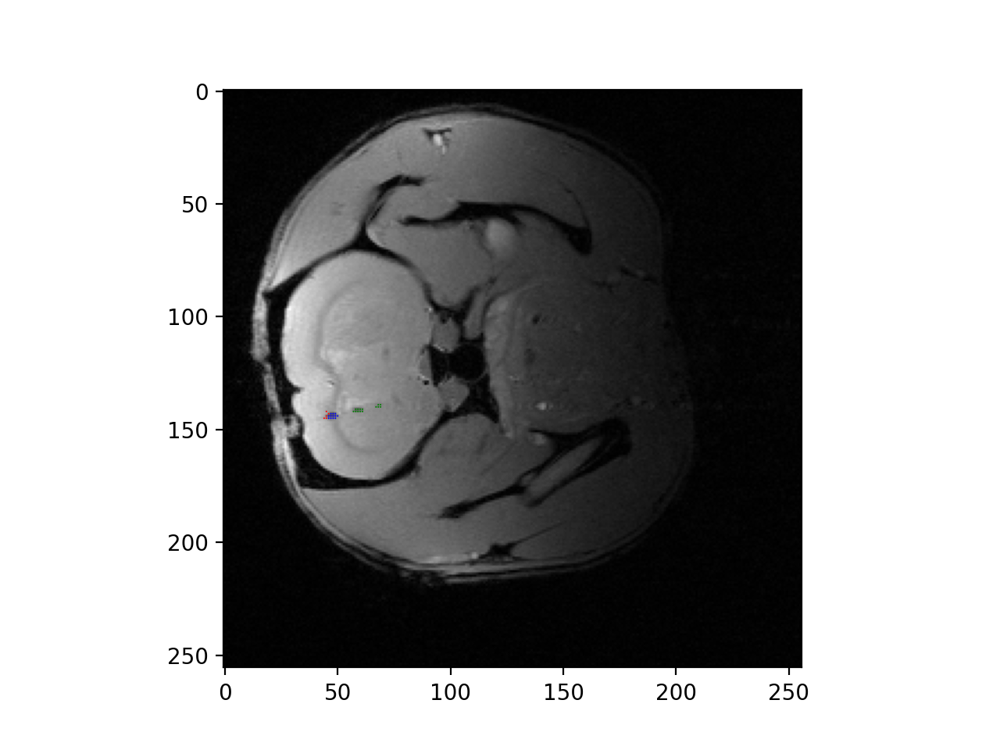

<IPython.core.display.Javascript object>


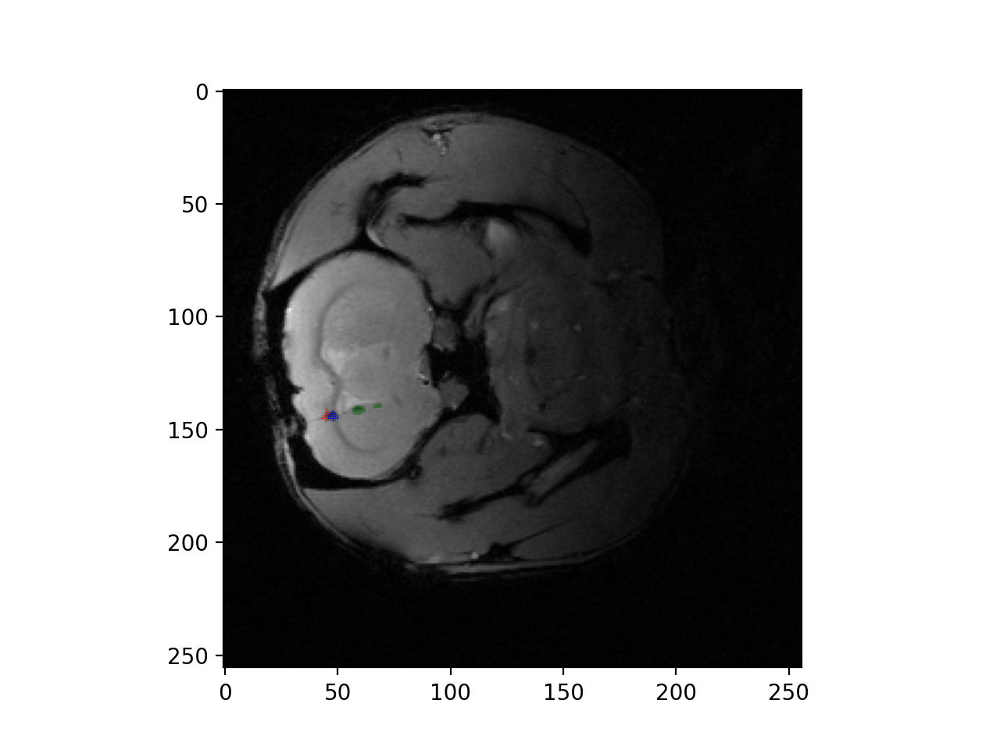

<IPython.core.display.Javascript object>


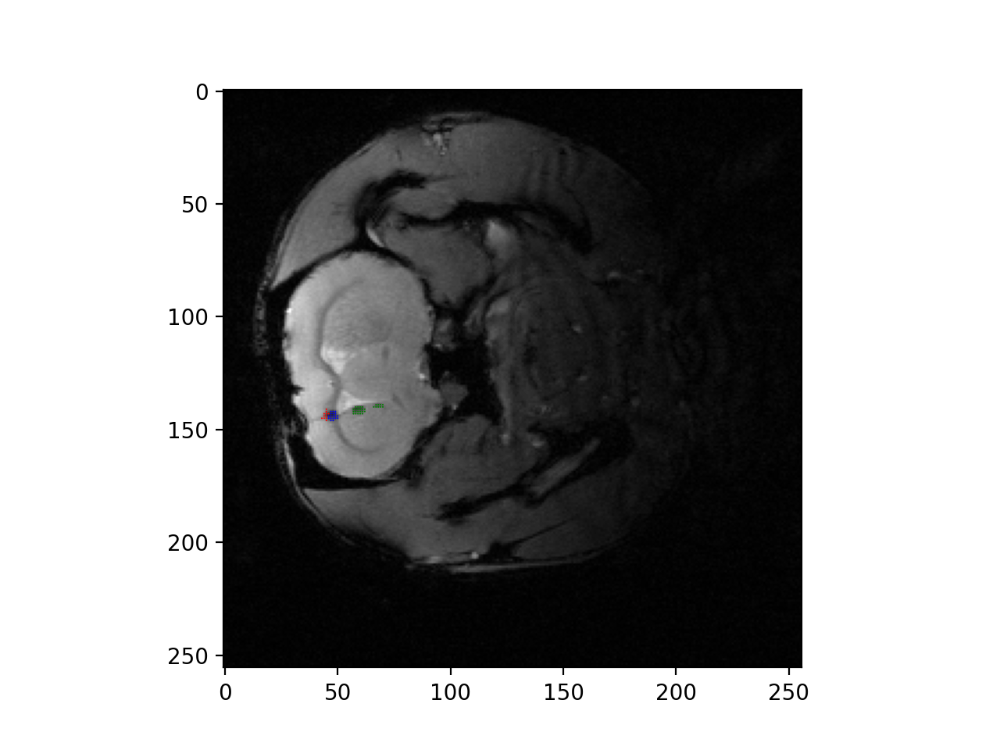

<IPython.core.display.Javascript object>


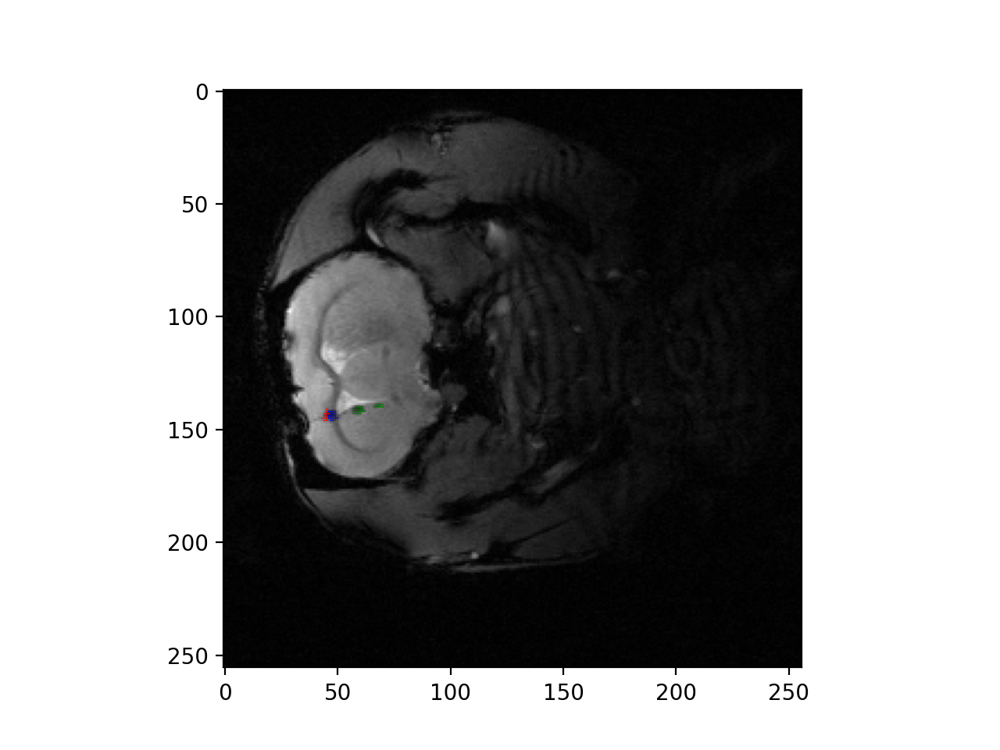

<IPython.core.display.Javascript object>


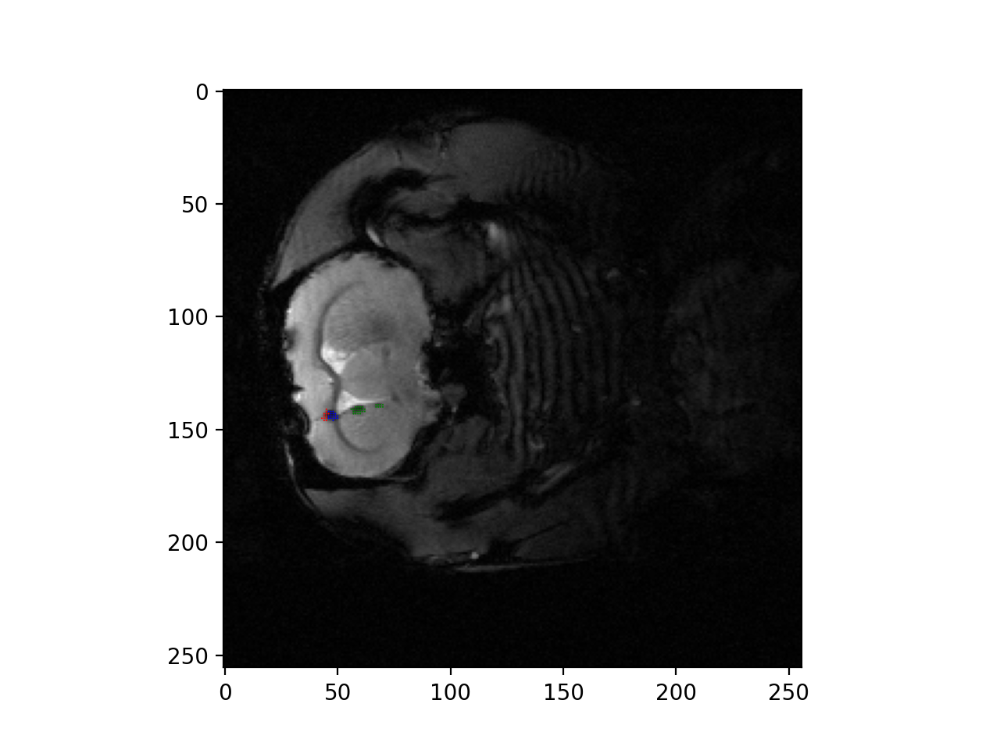

<IPython.core.display.Javascript object>


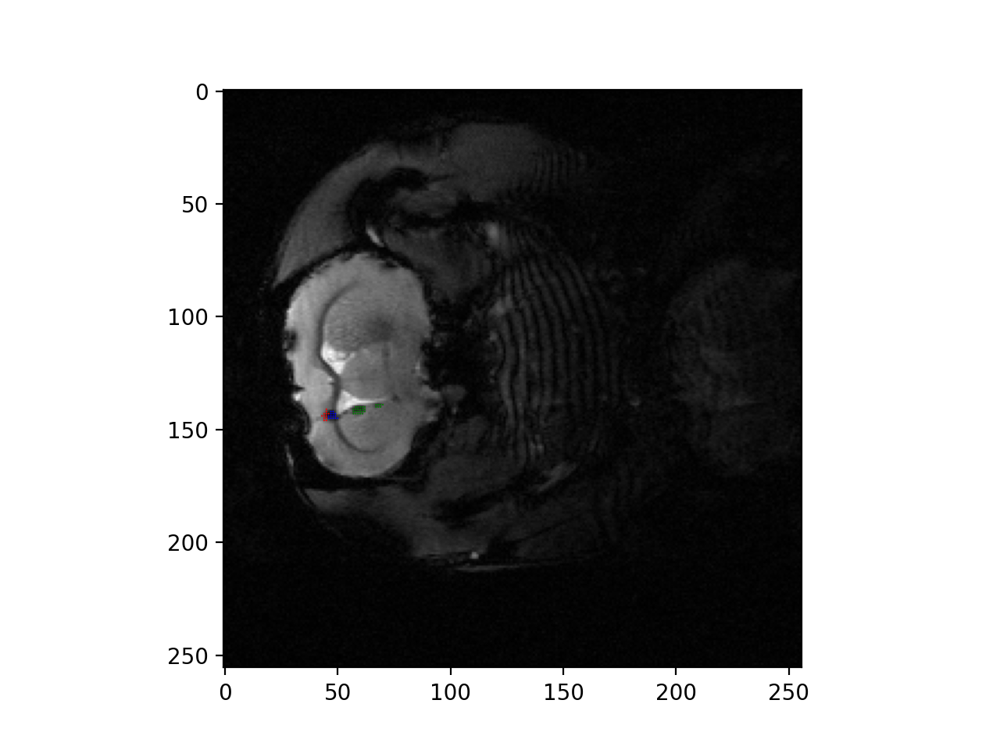

<IPython.core.display.Javascript object>


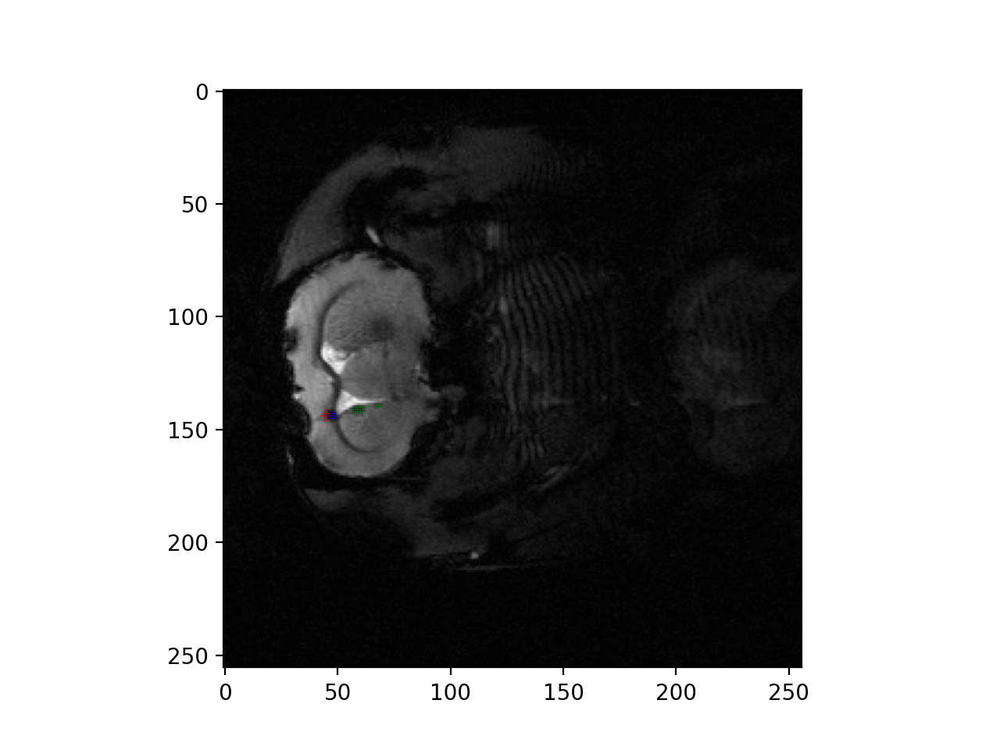

<IPython.core.display.Javascript object>


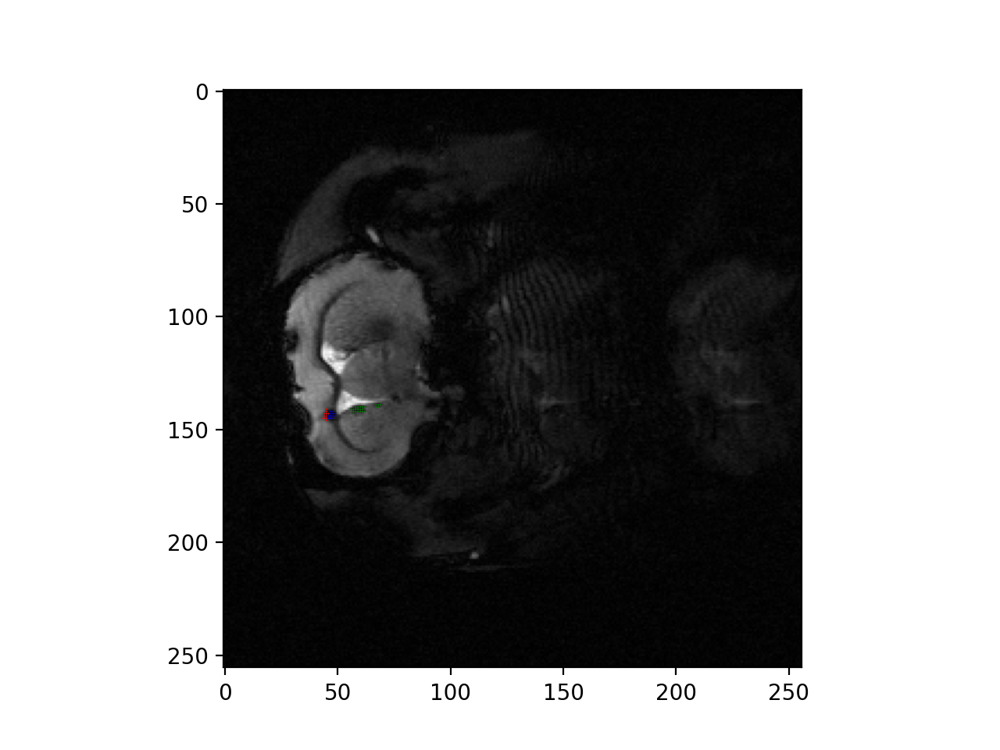

<IPython.core.display.Javascript object>


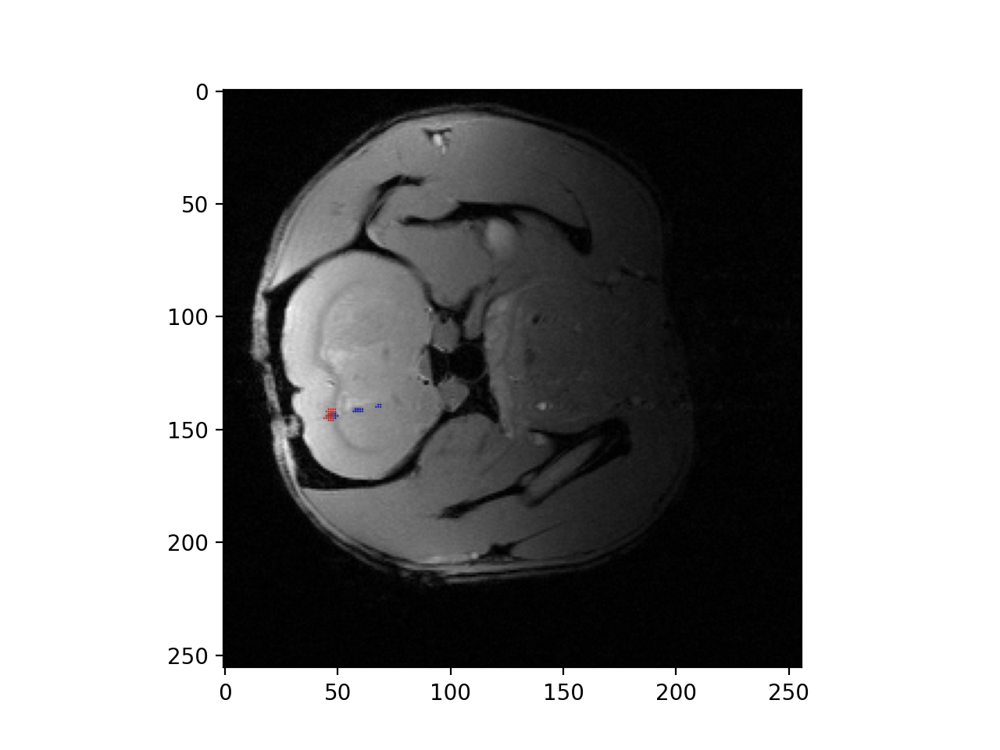

<IPython.core.display.Javascript object>


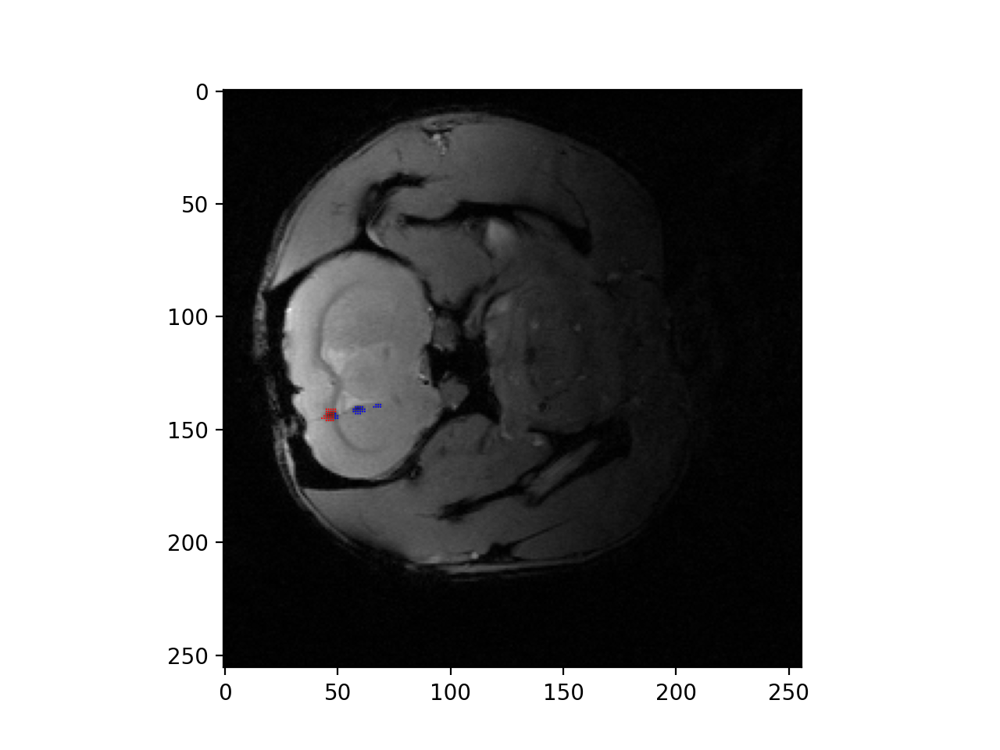

<IPython.core.display.Javascript object>


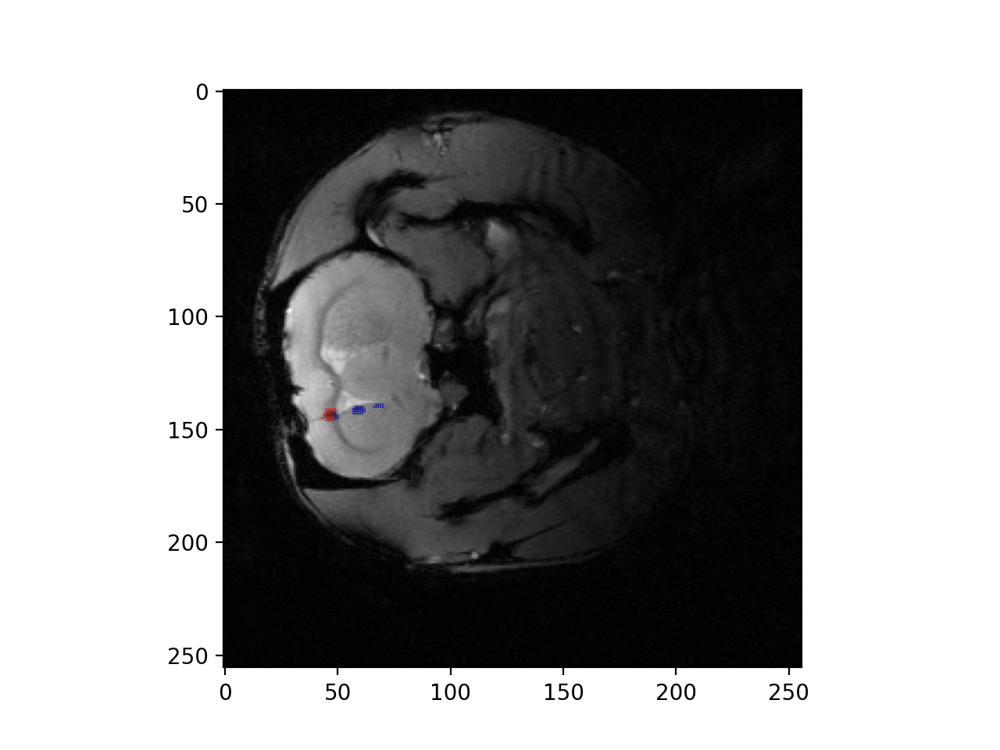

/Users/eminhanozil/opt/anaconda3/envs/IACV/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


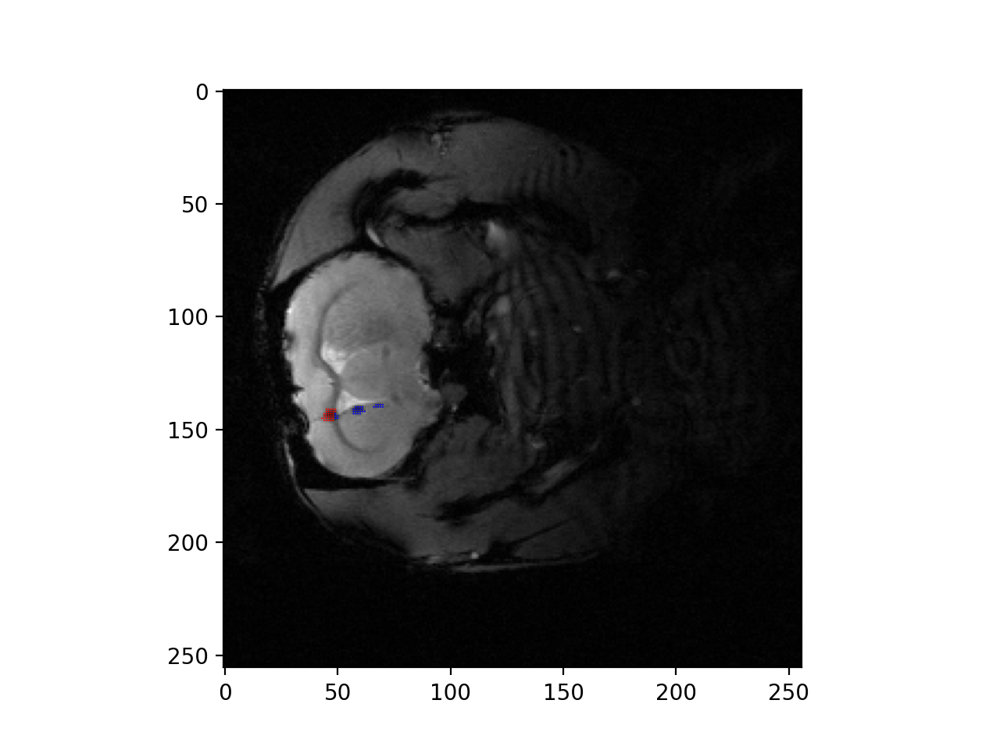

<IPython.core.display.Javascript object>


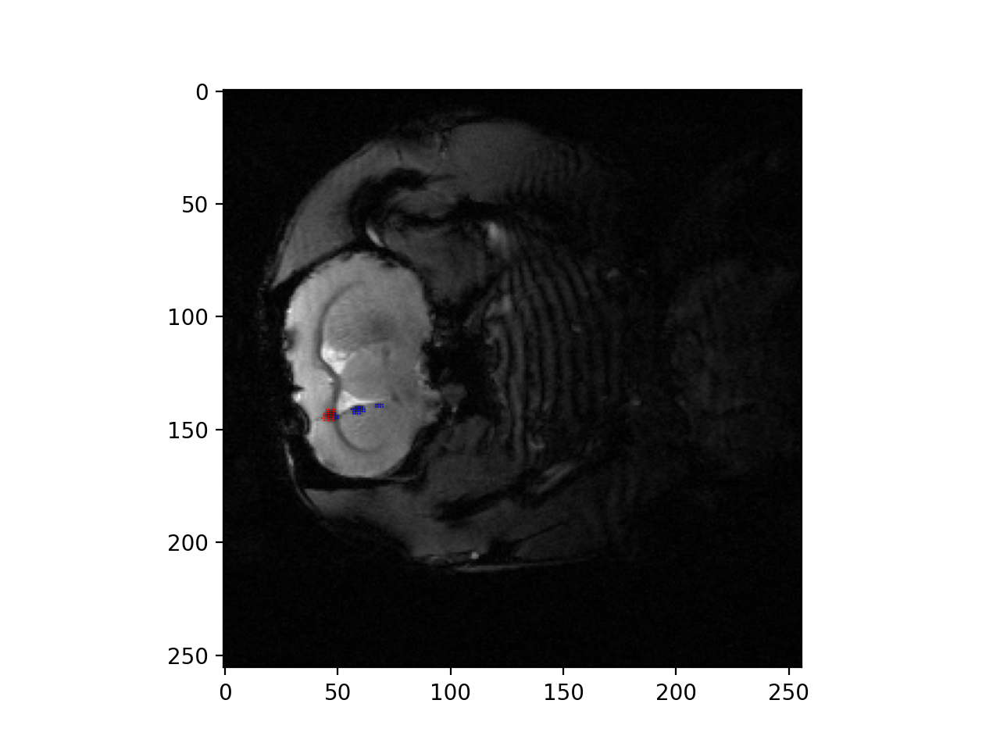

<IPython.core.display.Javascript object>


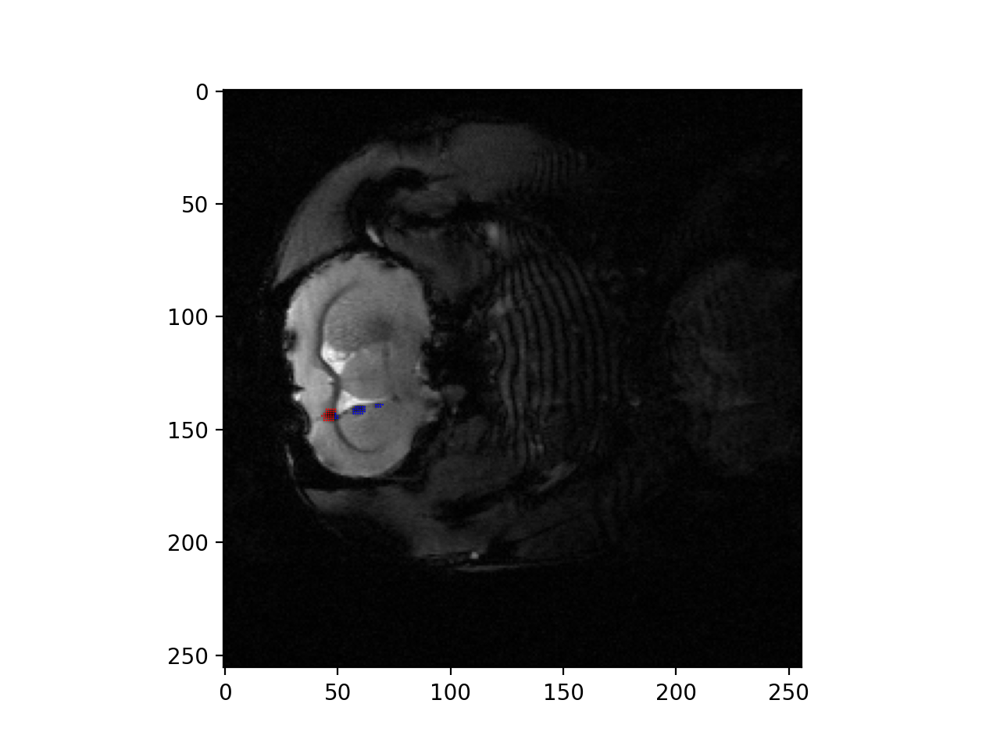

<IPython.core.display.Javascript object>


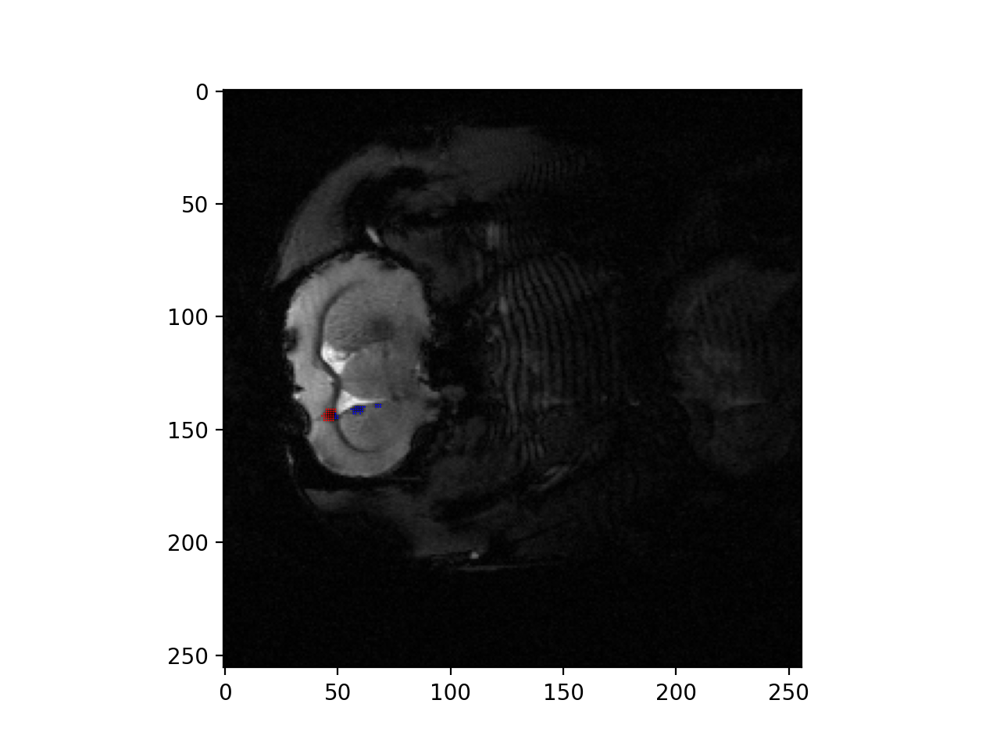

<IPython.core.display.Javascript object>


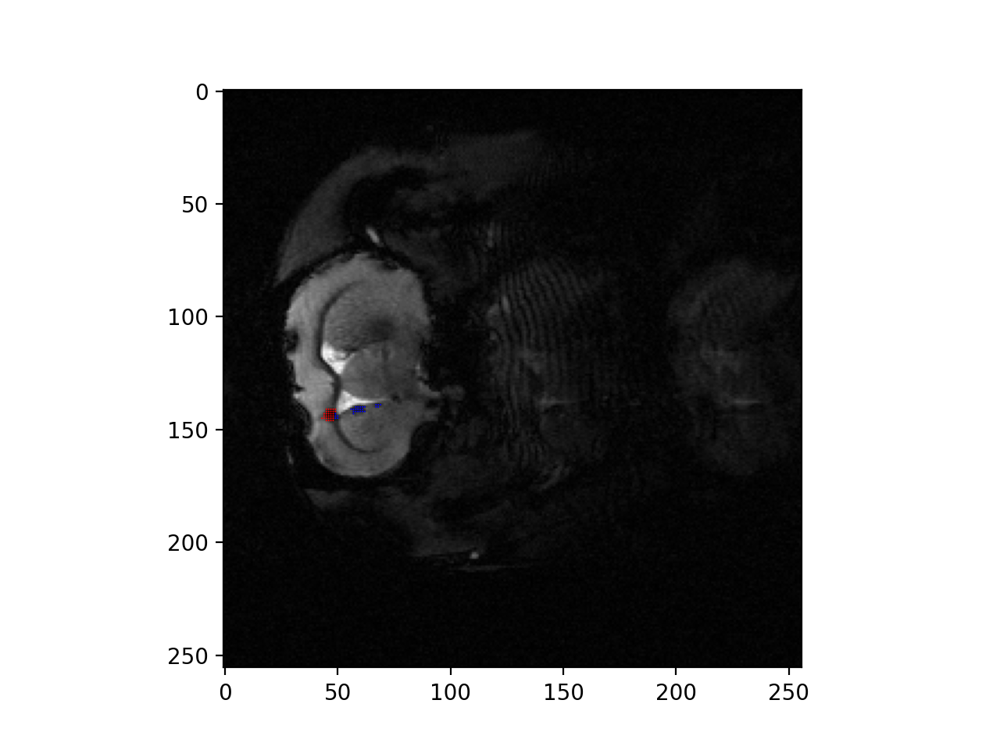

In [764]:
%run utils/plotters.ipynb
save_path=root+analysed+roi_name+"-regionspecific/roi-2/"
if not os.path.exists(save_path):
    os.mkdir(save_path)
plot_all_roi(data, trioDictCC, roi_name, save_path, num_echos=8, savefigs=True, dpi=3000)

save_path=root+analysed+roi_name+"-regionspecific/roi-3/"
if not os.path.exists(save_path):
    os.mkdir(save_path)
plot_all_roi(data, trioDict, roi_name, save_path, num_echos=8, savefigs=True, dpi=3000)

In [323]:
baseName="CC"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_cc=get_baseline_vals(base_seg, segmentation_mask, coronal2[:,:,img_slice,:])    

baseName="crtx"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_crtx=get_baseline_vals(base_seg, segmentation_mask, coronal2[:,:,img_slice,:])    

baseName="deepTissue"
base_seg=labelsdf["Labels"][labelsdf["Anatomical Regions"].str.contains(baseName)].values[0]
base_deep=get_baseline_vals(base_seg, segmentation_mask, coronal2[:,:,img_slice,:])    

In [716]:
segment_areas=np.flip([554, 2616, 5254])
segment_lengths=np.array([500, 493, 547])
segment_densities=segment_areas/segment_lengths
print(segment_densities)
trio_segment_densities=segment_densities
trio_areas=segment_areas

[10.508       5.30628803  1.01279707]


[719.34451148 421.50540467 161.9756044 ]
[981.86662122 718.88479273 289.21748467]
[849.71157751 690.36343595 289.39674886]
[981.90212652 555.68522438 288.92422739]
[849.57850277 690.60017085 289.25171436]
[718.8403099  718.95341184 421.48400513]
[718.81077471 555.66348289 289.21049342]
[690.18497093 555.47809277 289.22979857]


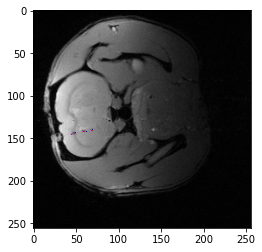

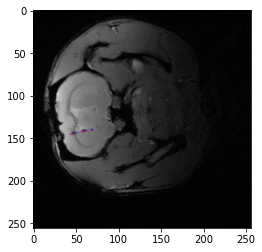

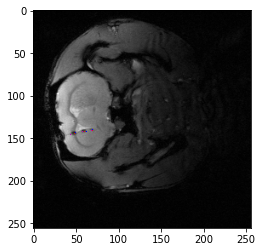

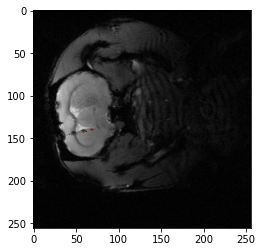

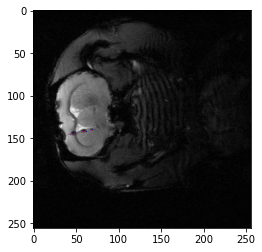

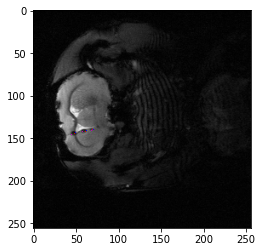

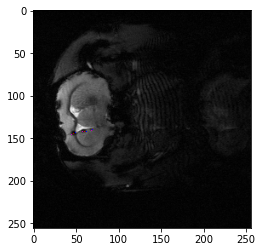

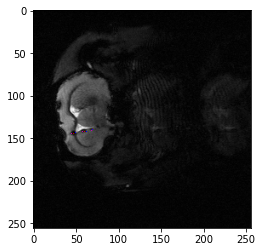

In [212]:
pattern_lengths=np.empty((num_echos, 3))
for echo in range(0,num_echos):
    farp, closep = get_endpoints(seg_areas, weightedCenters, masks, save_path, False)
    pattern_lengths[echo,:]=np.linalg.norm(farp-closep, axis=1)*136
    print(np.linalg.norm(farp-closep, axis=1)*136)
    

plt.plot(segment_densities,np.mean(pattern_lengths, axis=0))
plt.figure()
plt.plot(segment_densities,np.mean(px_count, axis=1))

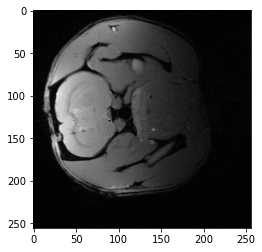

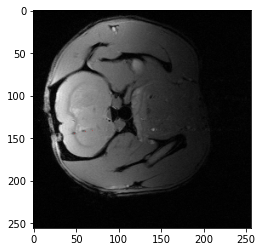

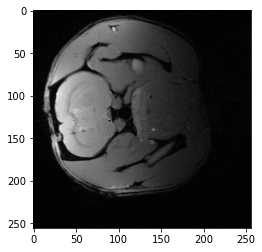

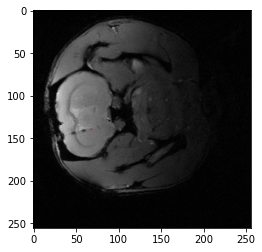

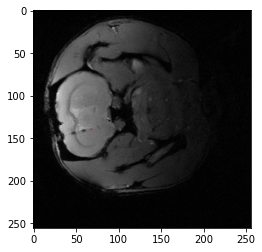

...

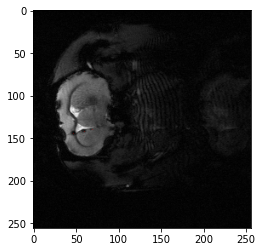

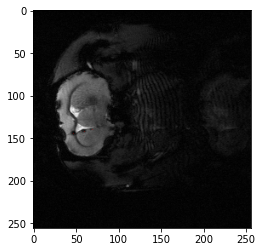

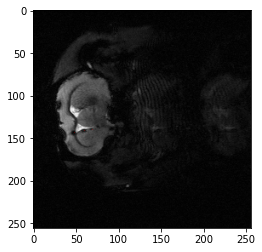

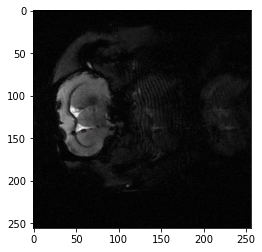

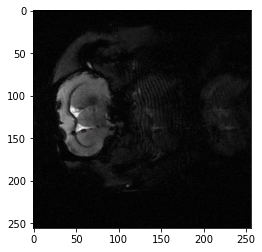

In [41]:
plot_centers(coronal2[:,:,img_slice,:], 8, minimas, avgCenters, weightedCenters)

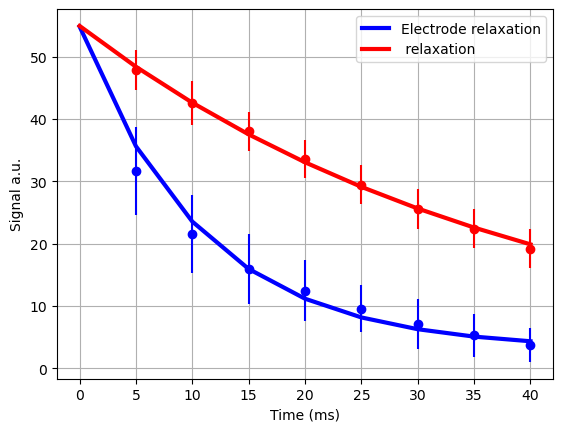

Pattern 0
t2star tissue: 25.39609672415236
t2star electrode: 92.81121314098428
difference: 67.41511641683192


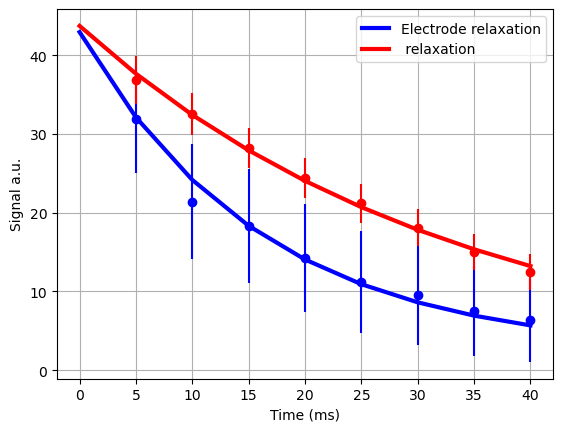

Pattern 2
t2star tissue: 29.90531880804438
t2star electrode: 61.939322736901886
difference: 32.0340039288575


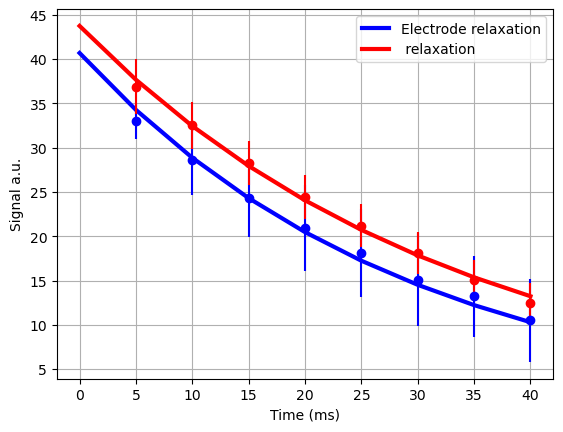

Pattern 3
t2star tissue: 29.90531880804438
t2star electrode: 34.35959277592002
difference: 4.45427396787564


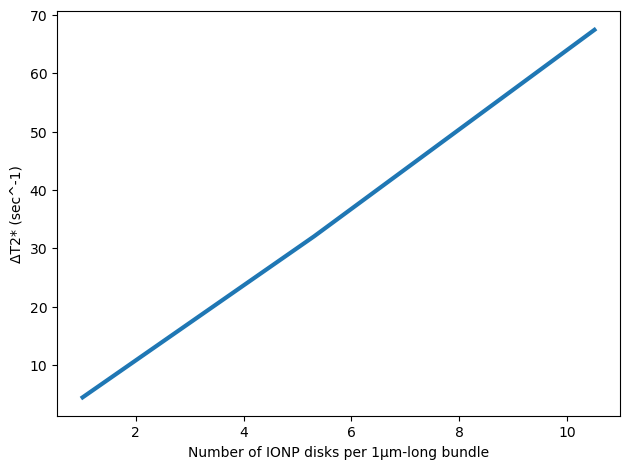

In [325]:
t2diff=[]
t2sigmas=[]

segment_lengths=np.array([500, 493, 547])
elecSegment=0
r=int(np.round(segment_lengths/136/2)[elecSegment])
paramsBase, paramsData, p_sigma_base, p_sigma_data=relaxation_fixedROI(coronal2[:,:,img_slice,:],
                                                                       (np.round(np.flip(weightedCenters[elecSegment,-1,:]))).astype(int),
                                                                       elecSegment, base_crtx, r=r)
print("Pattern 0")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
dt2=1000/paramsData[1]-1000/paramsBase[1]
print("difference: "+str(dt2))
s_combined=np.sqrt(p_sigma_base[1]**2 + p_sigma_data[1]**2)
t2sigmas.append((1000*s_combined)/(dt2*(dt2-s_combined)))
t2diff.append(1000/paramsData[1]-1000/paramsBase[1])



elecSegment=1
r=int(np.round(segment_lengths/136/2)[elecSegment])
paramsBase, paramsData, p_sigma_base, p_sigma_data=relaxation_fixedROI(coronal2[:,:,img_slice,:],
                                                                       (np.round(np.flip(weightedCenters[elecSegment,-1,:]))).astype(int),
                                                                       elecSegment, base_deep,r=r)
print("Pattern 2")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
dt2=1000/paramsData[1]-1000/paramsBase[1]
print("difference: "+str(dt2))
s_combined=np.sqrt(p_sigma_base[1]**2 + p_sigma_data[1]**2)
t2sigmas.append((1000*s_combined)/(dt2*(dt2-s_combined)))
t2diff.append(1000/paramsData[1]-1000/paramsBase[1])


elecSegment=2
r=int(np.round(segment_lengths/136/2)[elecSegment])

paramsBase, paramsData, p_sigma_base, p_sigma_data=relaxation_fixedROI(coronal2[:,:,img_slice,:],
                                                                       (np.round(np.flip(weightedCenters[elecSegment,-1,:]))).astype(int),
                                                                       elecSegment, base_deep,r=r)
print("Pattern 3")
print("t2star tissue: "+str(1000/paramsBase[1]))
print("t2star electrode: "+str(1000/paramsData[1]))
dt2=1000/paramsData[1]-1000/paramsBase[1]
print("difference: "+str(dt2))
s_combined=np.sqrt(p_sigma_base[1]**2 + p_sigma_data[1]**2)
t2sigmas.append((1000*s_combined)/(dt2*(dt2-s_combined)))
t2diff.append(1000/paramsData[1]-1000/paramsBase[1])

t2diffTrio=t2diff
segment_densities_trio=segment_densities
plt.figure()
# plt.errorbar(segment_densities, t2diff, yerr=t2sigmas, linewidth=3)
plt.plot(segment_densities, t2diff, linewidth=3)
plt.ylabel("ΔT2* (sec^-1)")
plt.xlabel("Number of IONP disks per 1µm-long bundle")
plt.tight_layout()
# plt.savefig(save_path+"relaxation_vs_density.pdf")



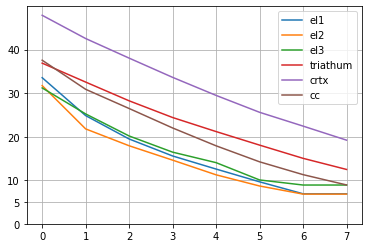

In [251]:
x=np.linspace(5,35,7)
# def relaxation(segments, num_echos, masks, data, img_slice):
num_segs=len(seg_areas)
pxIntMeans=np.empty((num_echos,num_segs))
pxIntstd=np.empty((num_echos,num_segs))

for echo in range(num_echos-1):
    img=coronal2[:,:,img_slice,echo]
    for j in range(num_segs):
        pxIntMeans[echo,j]=np.mean(img[masks[j,echo+1,:,:]==1])
        pxIntstd[echo,j]=np.std(img[masks[j,echo+1,:,:]==1])

    for j in range(num_segs):
        pxIntMeans[num_echos-1,j]=np.mean(img[masks[j,num_echos-1,:,:]==1])
        pxIntstd[num_echos-1,j]=np.std(img[masks[j,num_echos-1,:,:]==1])

plt.plot(pxIntMeans)
plt.plot(np.mean(base_deep, axis=0))
plt.plot(np.mean(base_crtx, axis=0))
plt.plot(np.mean(base_cc, axis=0))
plt.yticks([0,5,10,20,30,40])
plt.grid()
plt.legend(["el1","el2","el3","triathum","crtx","cc",])

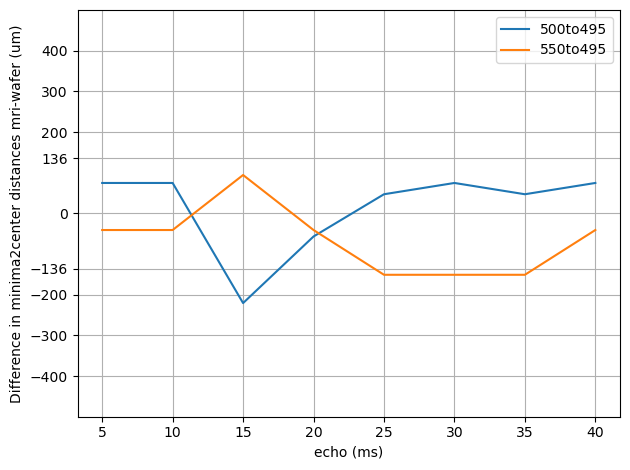

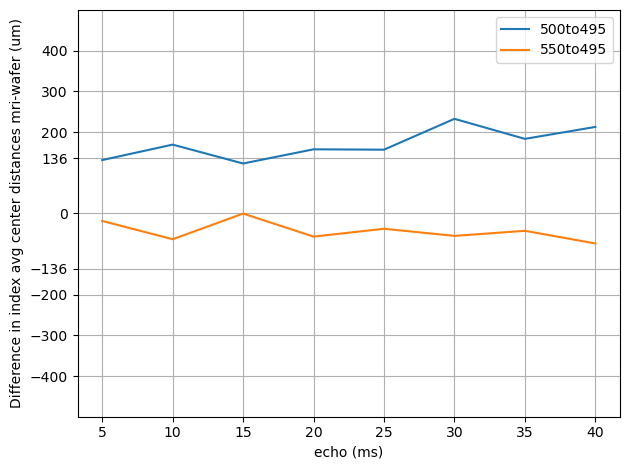

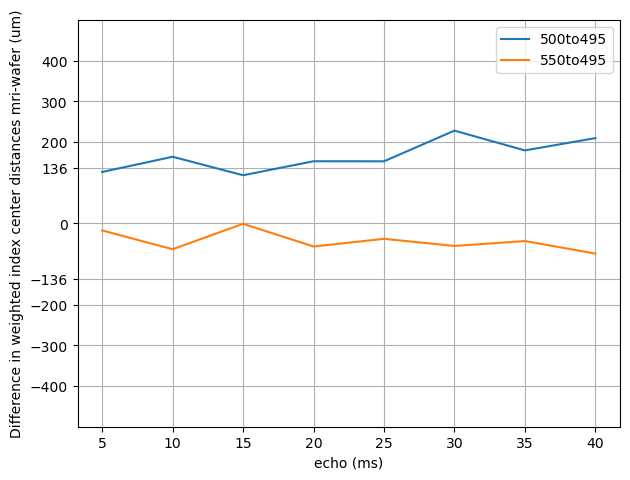

In [417]:
t3=550
t3t2=750 
t2=495
t2t1=1110
t1=500 
m=3

i=0
j=1
id0=m * i + j - ((i + 2) * (i + 1)) // 2
i=1
j=2
id1=m * i + j - ((i + 2) * (i + 1)) // 2
# wafer-level center2center distances of each pattern
c2c_dist = [((t2/2)+t2t1+(t1/2)), ((t3/2)+t3t2+(t2/2))]

# dist(X[i,:], X[j,:]) = dists[m * i + j - ((i + 2) * (i + 1)) // 2], X: m-by-n
distIdx=[id0,id1]
distsEchos=np.empty((len(distIdx),num_echos))
avgDistsEchos=np.empty_like(distsEchos)
weightedDistsEchos=np.empty_like(distsEchos)
for echo in range(num_echos):
    dists=spatial.distance.pdist(minimas[:,echo,:], metric="euclidean")
    dists2=spatial.distance.pdist(avgCenters[:,echo,:], metric="euclidean")
    dists3=spatial.distance.pdist(weightedCenters[:,echo,:], metric="euclidean")
    distsEchos[:,echo]=dists[distIdx]*136
    avgDistsEchos[:,echo]=dists2[distIdx]*136
    weightedDistsEchos[:,echo]=dists3[distIdx]*136
    

## Segment vs echo
x=np.linspace(5,40,8)
plt.figure()
plt.plot(x,(distsEchos-np.reshape(c2c_dist, (-1,1)))[0,:])
plt.plot(x,(distsEchos-np.reshape(c2c_dist, (-1,1)))[1,:])
plt.xlabel("echo (ms)")
# plt.xticks([0, 1])
plt.yticks([-400, -300, -200, -136, 0, 136, 200, 300, 400])
plt.ylabel("Difference in minima2center distances mri-wafer (um)")
plt.ylim([-500, 500])
plt.legend([str(t1)+"to"+str(t2), str(t3)+"to"+str(t2)])
plt.grid()
filename="minima-center2center-echos.pdf"
plt.tight_layout()
# plt.savefig(save_path+filename, dpi=dpi)

plt.figure()
plt.plot(x,(avgDistsEchos-np.reshape(c2c_dist, (-1,1)))[0,:])
plt.plot(x,(avgDistsEchos-np.reshape(c2c_dist, (-1,1)))[1,:])
plt.xlabel("echo (ms)")
# plt.xticks([0, 1])
plt.yticks([-400, -300, -200, -136, 0, 136, 200, 300, 400])
plt.ylabel("Difference in index avg center distances mri-wafer (um)")
plt.ylim([-500, 500])
plt.legend([str(t1)+"to"+str(t2), str(t3)+"to"+str(t2)])
plt.grid()
filename="avgindex-center2center-echos.pdf"
plt.tight_layout()
# plt.savefig(save_path+filename, dpi=dpi)

plt.figure()
plt.plot(x,(weightedDistsEchos-np.reshape(c2c_dist, (-1,1)))[0,:])
plt.plot(x,(weightedDistsEchos-np.reshape(c2c_dist, (-1,1)))[1,:])
plt.xlabel("echo (ms)")
# plt.xticks([0, 1])
plt.yticks([-400, -300, -200, -136, 0, 136, 200, 300, 400])
plt.ylabel("Difference in weighted index center distances mri-wafer (um)")
plt.ylim([-500, 500])
plt.legend([str(t1)+"to"+str(t2), str(t3)+"to"+str(t2)])
plt.grid()
filename="weightedindex-center2center-echos.pdf"
plt.tight_layout()
# plt.savefig(save_path+filename, dpi=dpi)

trio_c2c=c2c_dist

# ALL COMPARISON

## Relaxation

In [365]:
# def len2density(bundleLen):
bundleLenTrimmed=np.array(bundleLenMono)
bundleLenTrimmed[np.where(bundleLenTrimmed>3400)]=3400
onsetFiber=2
bundleDensity=(bundleLenTrimmed/50+onsetFiber)*0.18
mono_density=bundleDensity[:-5]
mono_t2sdiff=t2diffMono[:-5]

In [416]:
all_densities = np.concatenate((mono_density, duo_segment_density, trio_segment_densities, quad_segment_densities))
all_t2diff = np.concatenate((mono_t2sdiff, duo_t2s_diff, t2diffTrio, t2diffQuad))
r2s=1523.5 #mM^-1 . sec^-1

d=1
z=np.polyfit(all_densities, all_t2diff, d)

def dens2conc(x):
    return x * z[0] / r2s

def conc2dens(x):
    return x * r2s / z[0]

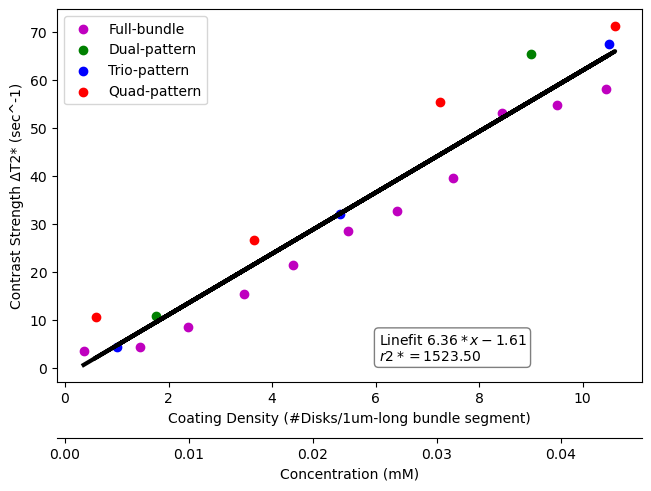

In [415]:
fig, ax = plt.subplots(constrained_layout=True)

ax.scatter(bundleDensity[:-5], t2diffMono[:-5], c='m')
ax.scatter(duo_segment_density, duo_t2s_diff, c='g')
ax.scatter(trio_segment_densities, t2diffTrio,c='b')
ax.scatter(quad_segment_densities, t2diffQuad, c='r')
ax.plot(all_densities, all_densities*z[0]+z[1], linewidth=3, c="black")

ax.legend(["Full-bundle","Dual-pattern", "Trio-pattern", "Quad-pattern"])
ax.set_ylabel("Contrast Strength ΔT2* (sec^-1)")
# plt.xlabel("Number of IONP disks per 1µm-long bundle")

ax.set_xlabel("Coating Density (#Disks/1um-long bundle segment)")
secax = ax.secondary_xaxis(-0.15, functions=(dens2conc, conc2dens))
secax.set_xlabel('Concentration (mM)')

# textstr=r'Linefit $z[0]=%.2f$' % z[0] 
textstr = '\n'.join((r'Linefit $%.2f * x %.2f$' % (z[0], z[1]),
    r'$r2*=%.2f$' % (r2s, )))

props = dict(boxstyle='round', facecolor='white', alpha=0.5)
ax.text(0.55, 0.05, textstr, transform=ax.transAxes, fontsize=10,
        verticalalignment='bottom', bbox=props)

plt.show()
fig.savefig(root+analysed+"all-comparison-relaxation_vs_density&concentration.pdf")

## Center 2 Center distances

8
8
8


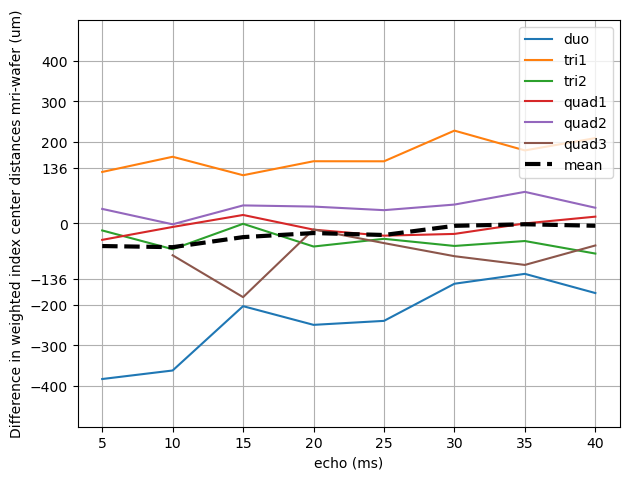

In [490]:
%run utils/geometry.ipynb

duo_dists=get_dist(duo_weightedCenters)
trio_dists=get_dist(trio_weightedCenters)
quad_dists=get_dist(quad_weightedCenters)

duo_diff=np.transpose(duo_dists-np.reshape(duo_c2c, (-1,1)))
trio_diff=np.transpose(trio_dists-np.reshape(trio_c2c, (-1,1)))
quad_diff=np.transpose(quad_dists-np.reshape(quad_c2c, (-1,1)))

all_diff=np.concatenate((duo_diff, trio_diff, quad_diff), axis=1)
all_diff[0,:][np.isnan(all_diff[0,:])]=np.mean(all_diff[0,:][~np.isnan(all_diff[0,:])])

echos=np.linspace(5,40,8)

plt.plot(echos,duo_diff)
plt.plot(echos,trio_diff)
plt.plot(echos,quad_diff)
plt.plot(echos,np.mean(all_diff, axis=1), linewidth=3, linestyle='dashed', c='black')

plt.xlabel("echo (ms)")
# plt.xticks([0, 1])
plt.yticks([-400, -300, -200, -136, 0, 136, 200, 300, 400])
plt.ylabel("Difference in weighted index center distances mri-wafer (um)")
plt.ylim([-500, 500])
plt.legend(["duo", "tri1", "tri2", "quad1", "quad2", "quad3", "mean"])
plt.grid()
filename="all_c2c_diff.pdf"
plt.tight_layout()
dpi=1000
plt.savefig(root+analysed+filename, dpi=dpi)


In [726]:
%run utils/geometry.ipynb

quadDict=get_centers(quadDict)
quad_effectSizes=get_effectsize(quadDict)
quad_effectSizesCC=get_effectsize(quadDictCC)

trio_effectSizes=get_effectsize(trioDict)
trio_effectSizesCC=get_effectsize(trioDictCC)

areas=np.concatenate((trio_areas, quad_areas))
effectSizes=np.concatenate((np.concatenate((trio_effectSizesCC[:4,:], trio_effectSizes[4:,:]), axis=0), np.concatenate((quad_effectSizesCC[:4,:], quad_effectSizes[4:,:]), axis=0)), axis=1)
effectSizes=effectSizes[:,areas.argsort()]
areas=np.sort(areas)

<IPython.core.display.Javascript object>


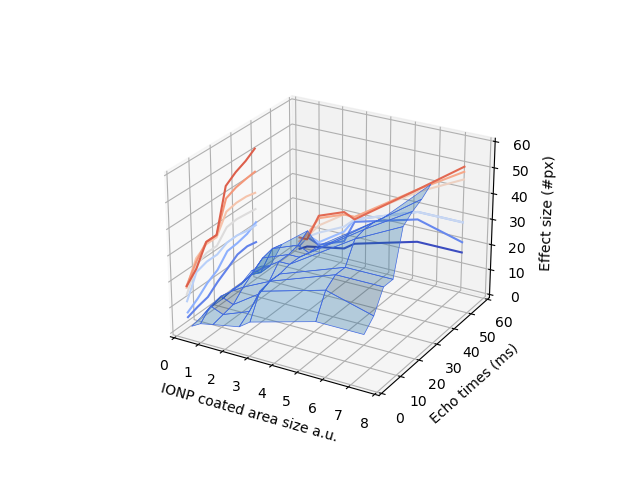

In [738]:
from matplotlib import cm
%matplotlib notebook


X, Y = np.meshgrid(areas/1000, np.linspace(5,40,8))


ax = plt.figure().add_subplot(projection='3d')
ax.plot_surface(X, Y, effectSizes, edgecolor='royalblue', lw=0.5, rstride=1, cstride=1,
                alpha=0.3)

# ax.contour(X, Y,effectSizes, zdir='z', offset=0, cmap='coolwarm')
ax.contour(X, Y, effectSizes, zdir='x', offset=0, cmap='coolwarm')
ax.contour(X, Y, effectSizes, zdir='y', offset=60, cmap='coolwarm')

ax.set(xlim=(0, 8), ylim=(0, 60), zlim=(0, 60),
       xlabel='X', ylabel='Y', zlabel='Z')
ax.set_xlabel("IONP coated area size a.u.")
ax.set_ylabel("Echo times (ms)")
ax.set_zlabel("Effect size (#px)")
ax.view_init(elev=25, azim=-60)
plt.savefig(root+analysed+"effectsize.pdf", dpi=1000)
plt.show()